benign (111)


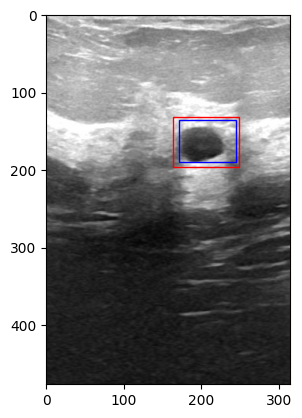

benign (126)


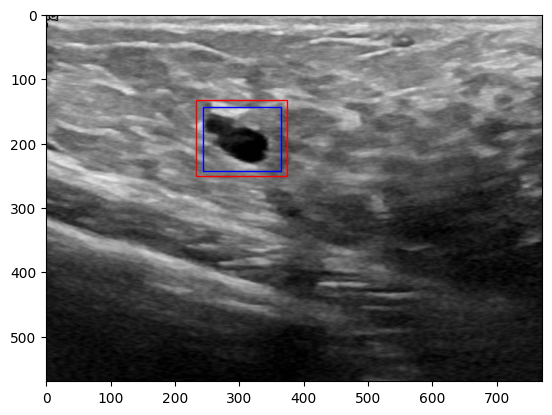

benign (341)


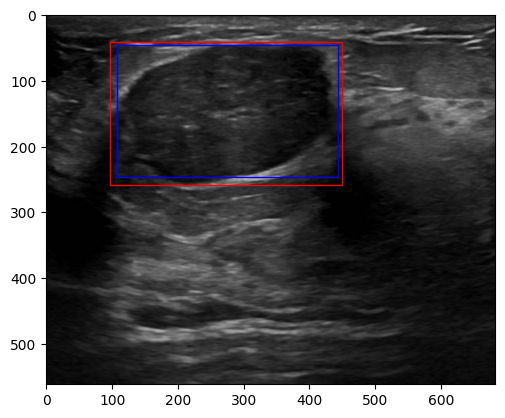

benign (271)


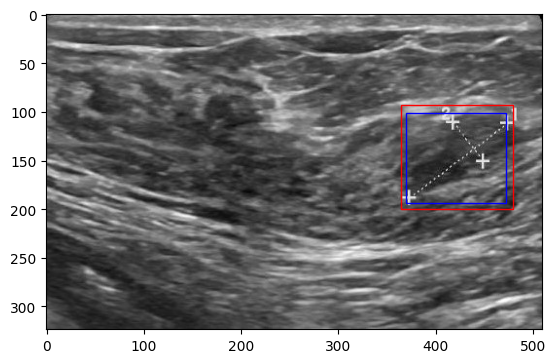

benign (186)


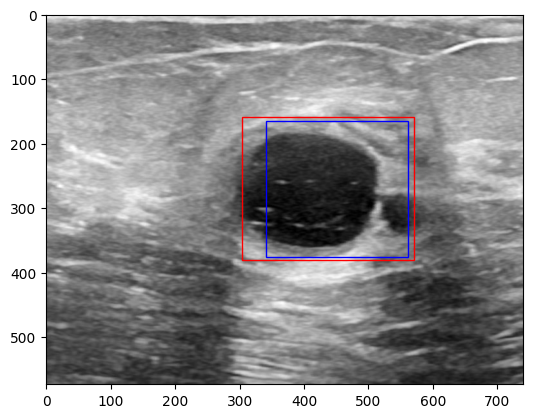

benign (129)


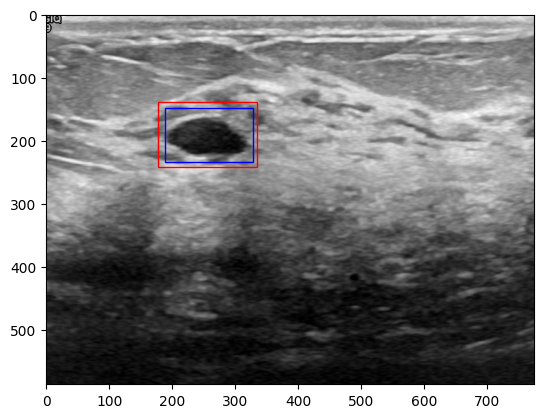

benign (313)


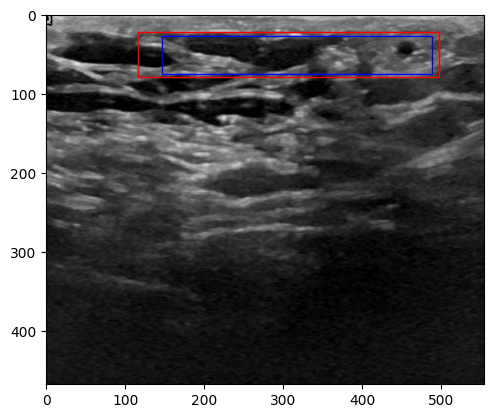

benign (59)


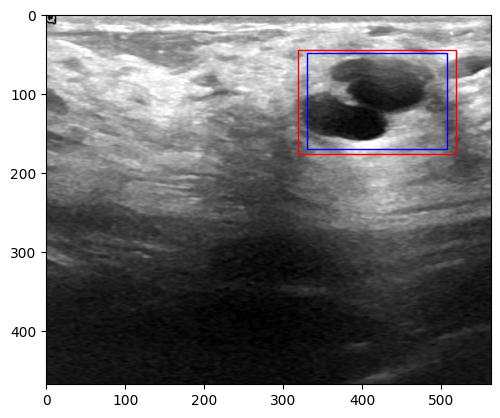

benign (378)


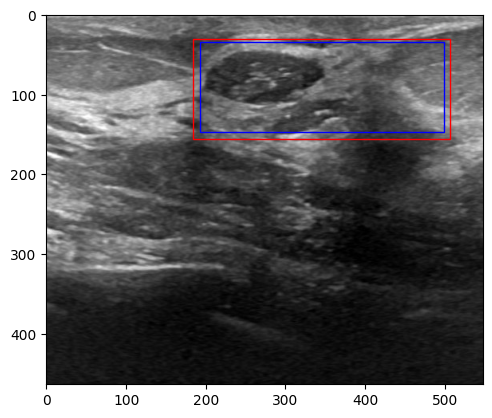

benign (278)


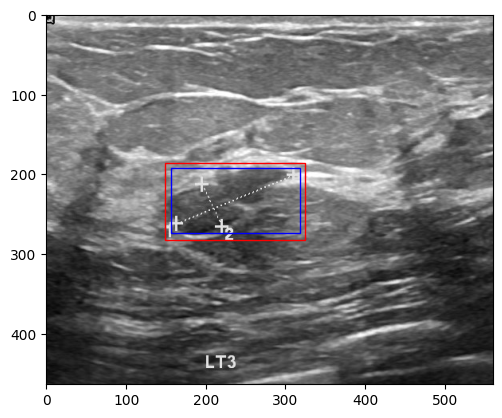

benign (345)


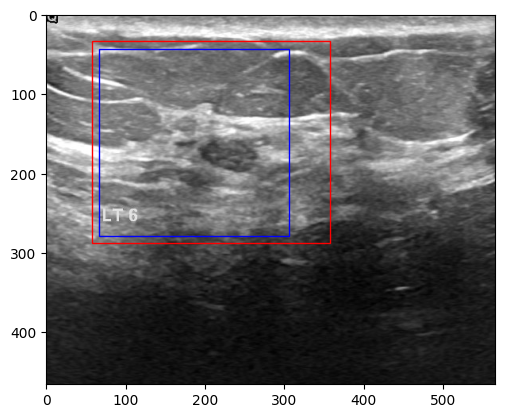

benign (403)


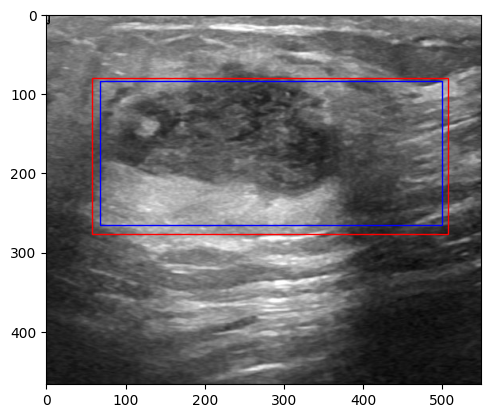

benign (275)


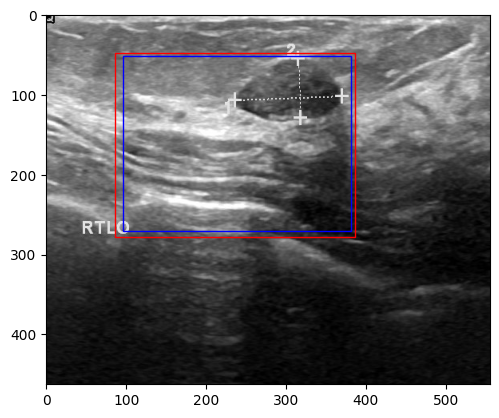

benign (340)


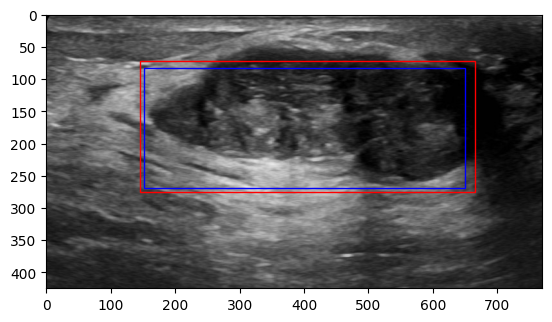

benign (316)


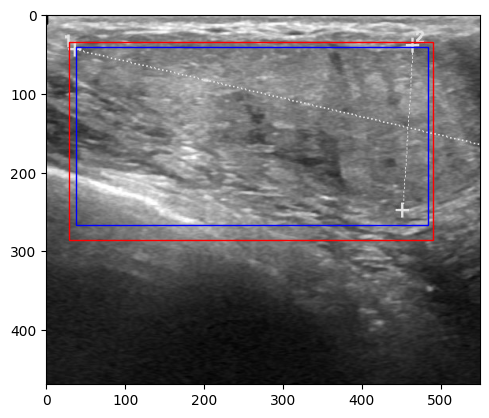

benign (114)


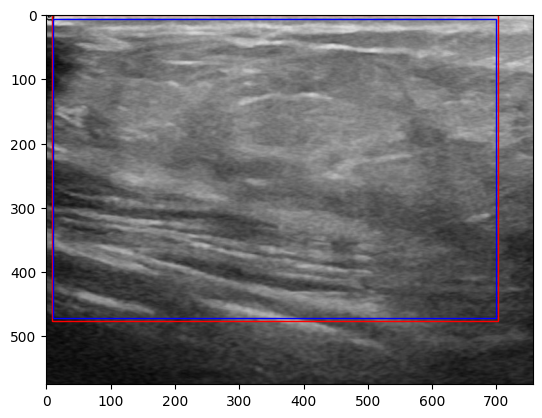

benign (406)


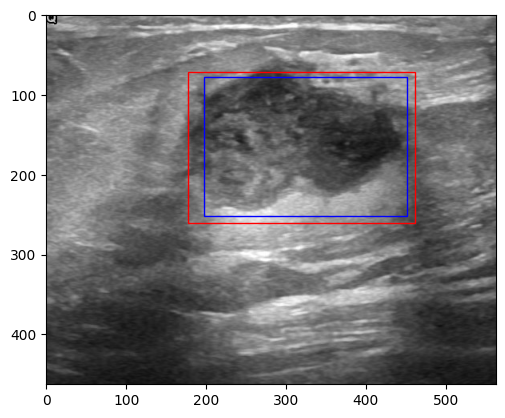

benign (183)


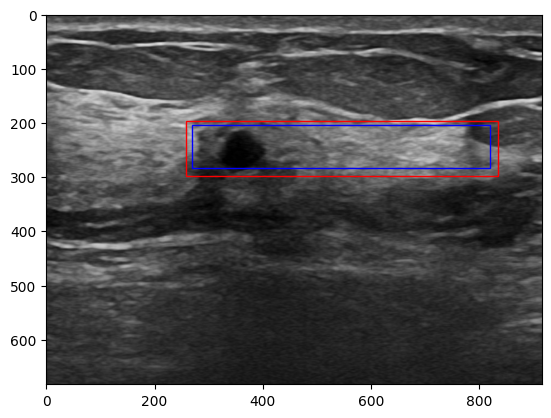

benign (83)


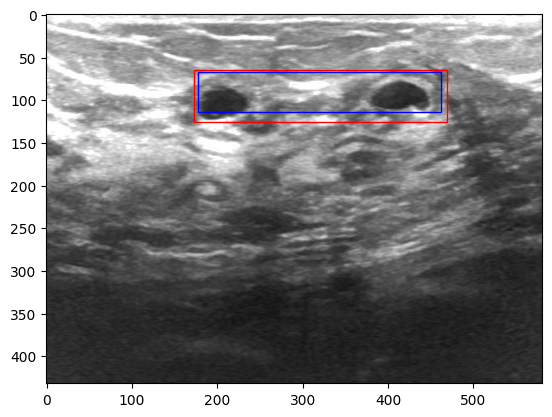

benign (130)


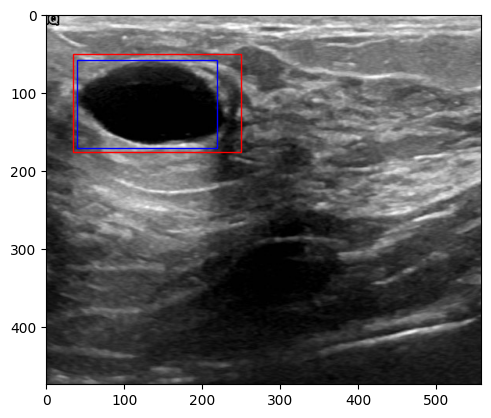

benign (161)


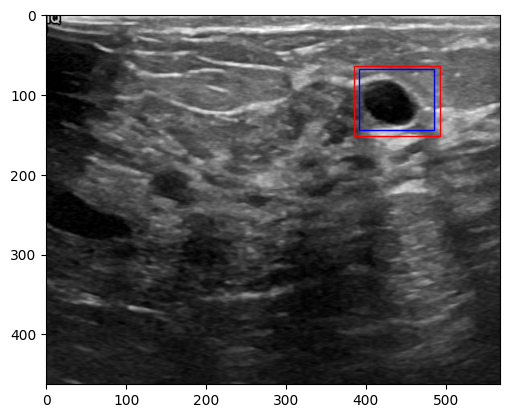

benign (375)


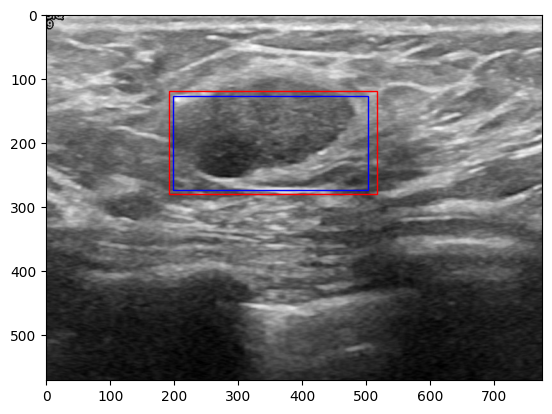

benign (20)


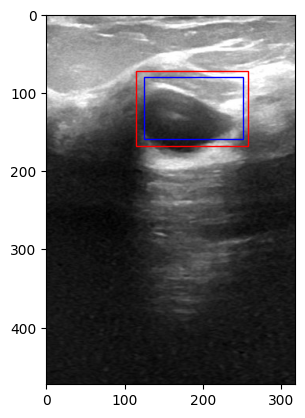

benign (26)


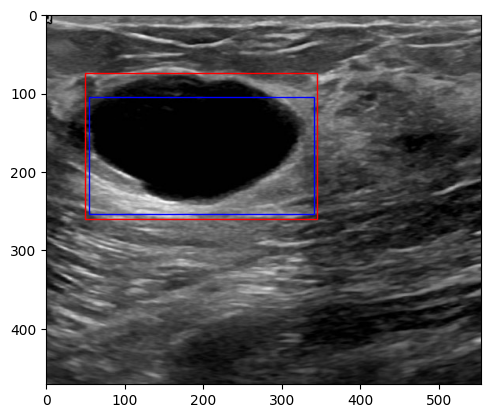

benign (40)


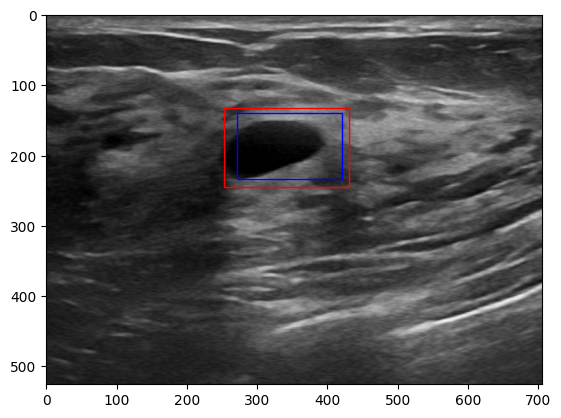

benign (139)


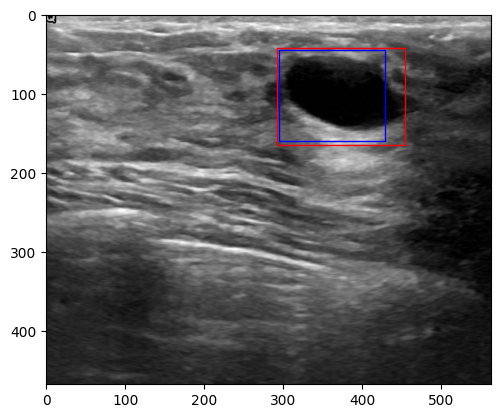

benign (355)


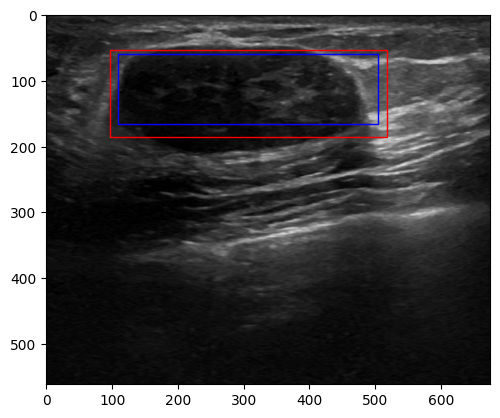

benign (281)


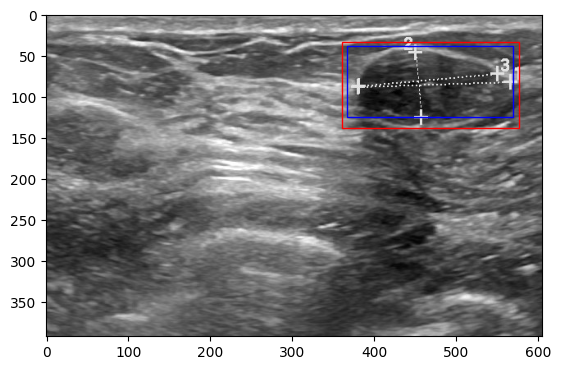

benign (101)


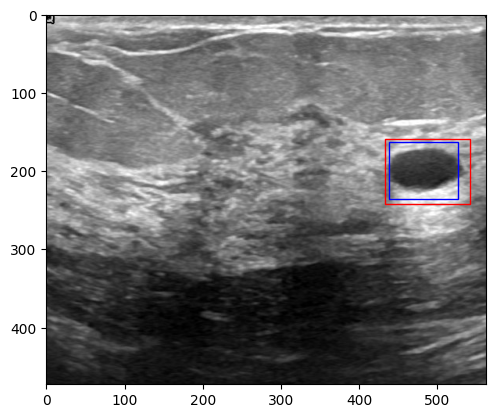

benign (163)


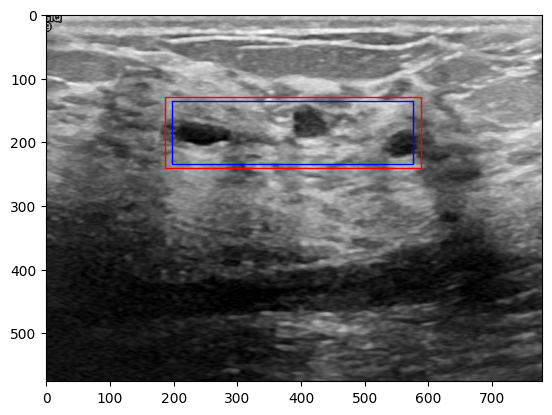

benign (153)


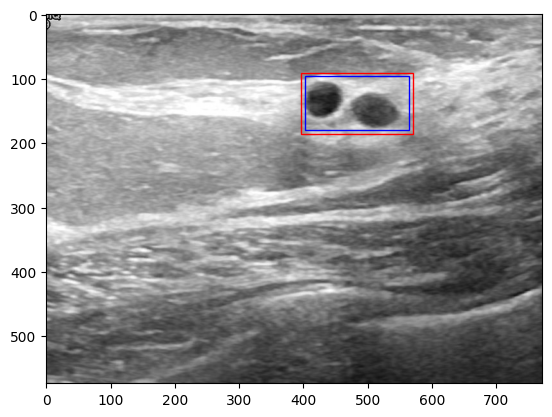

benign (382)


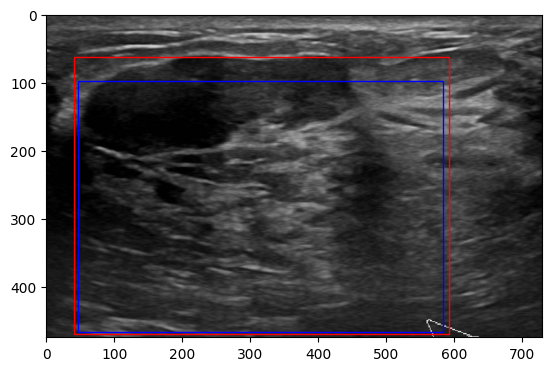

benign (380)


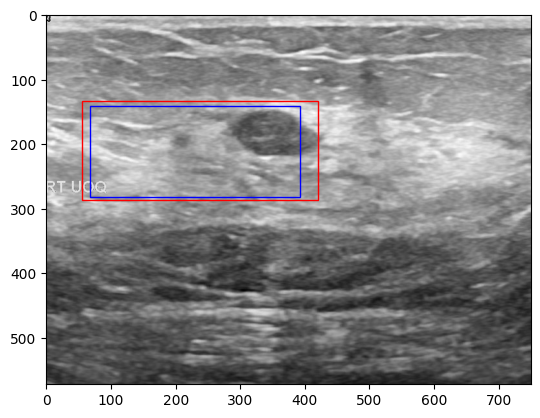

benign (402)


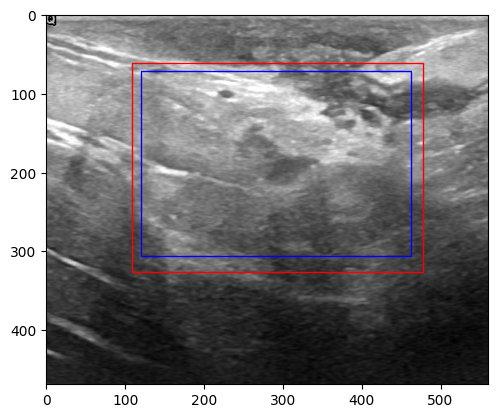

benign (174)


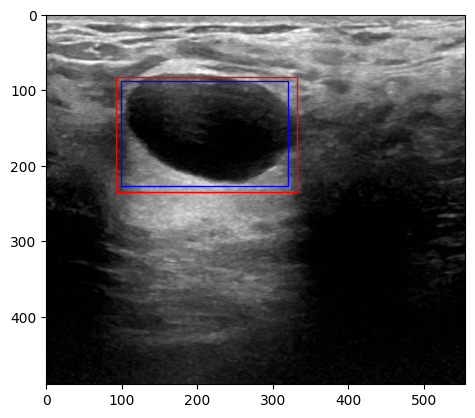

benign (124)


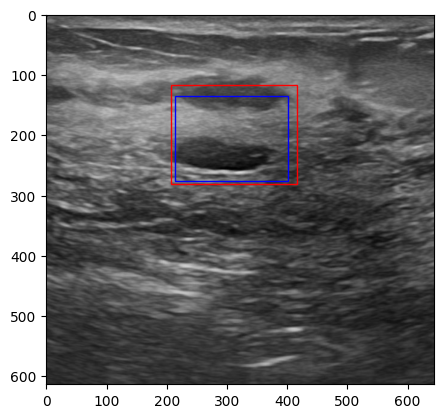

benign (222)


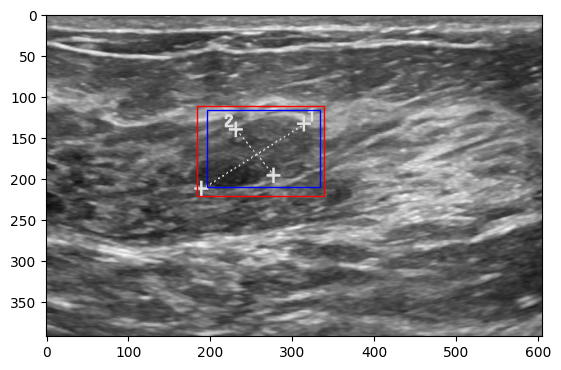

benign (430)


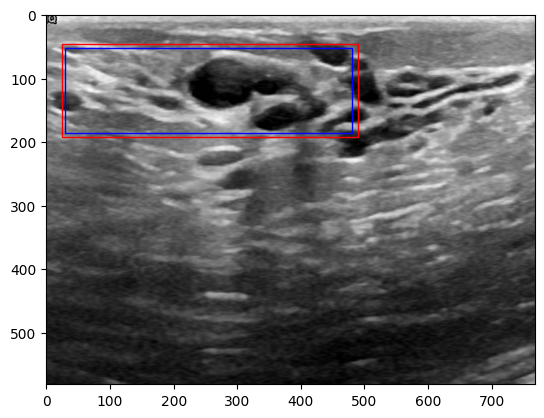

benign (52)


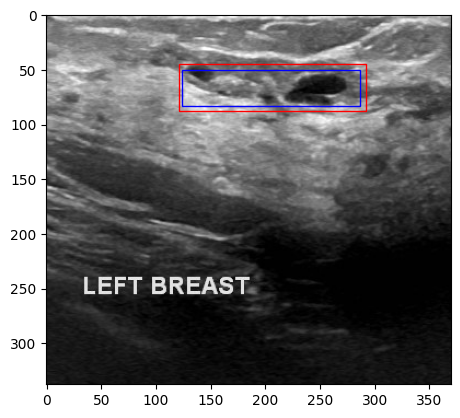

benign (358)


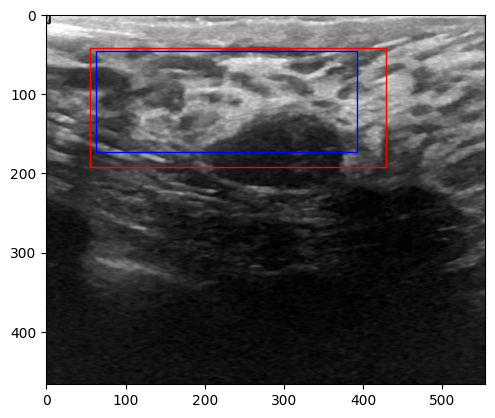

benign (2)


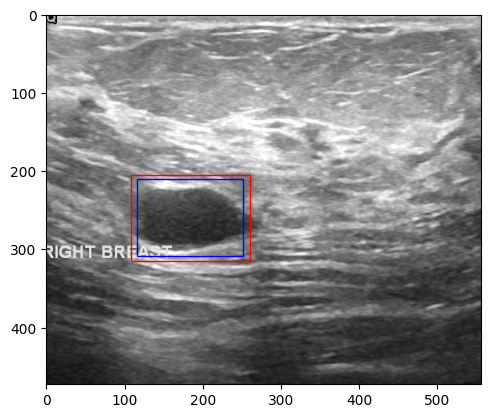

benign (416)


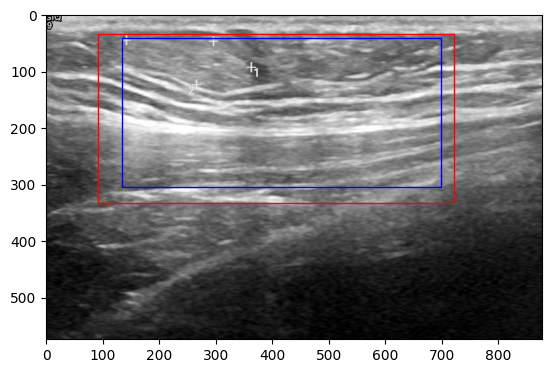

benign (293)


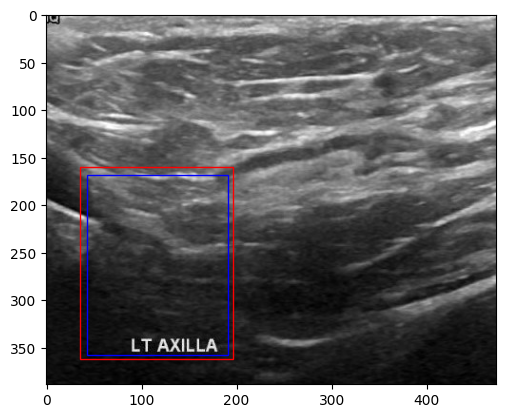

benign (276)


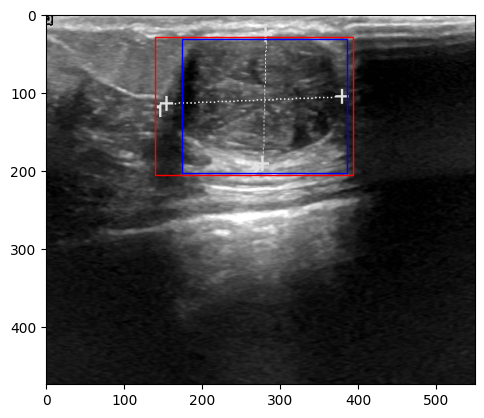

benign (34)


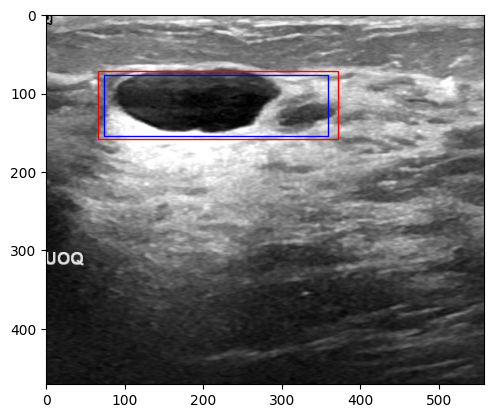

benign (409)


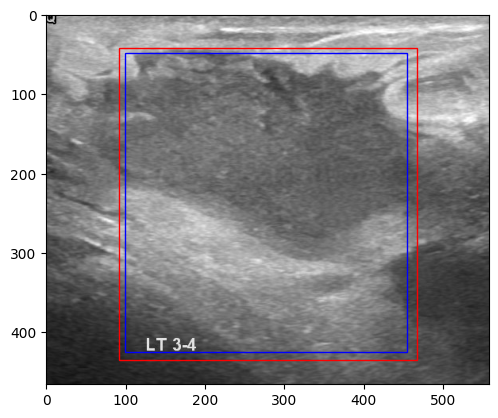

benign (284)


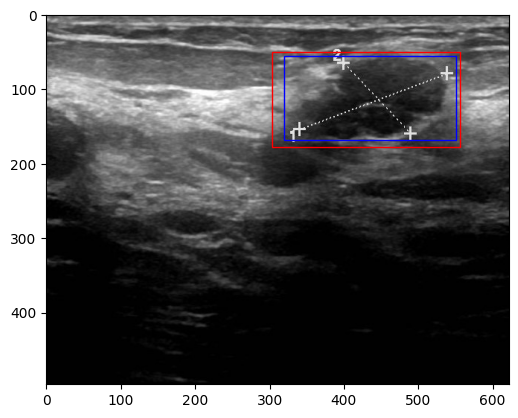

benign (232)


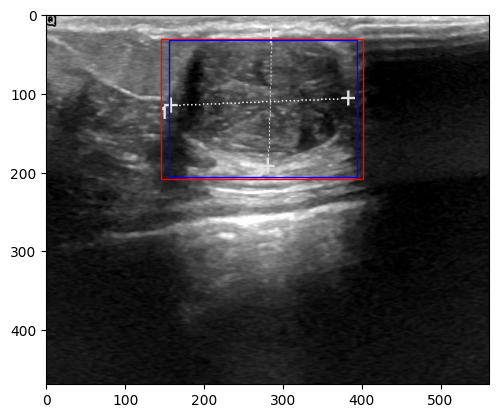

benign (23)


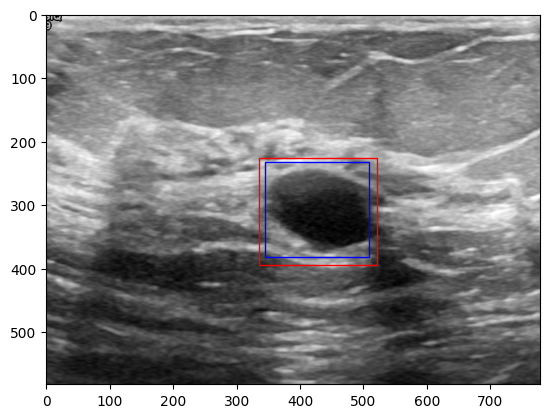

benign (88)


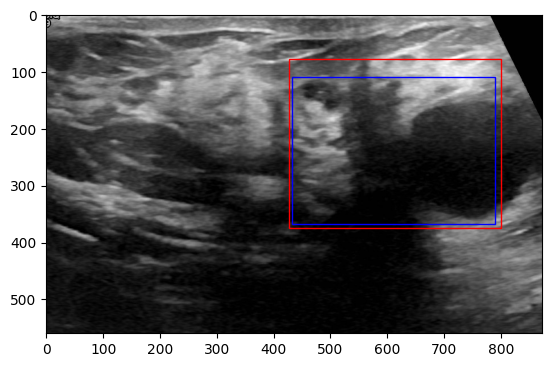

benign (61)


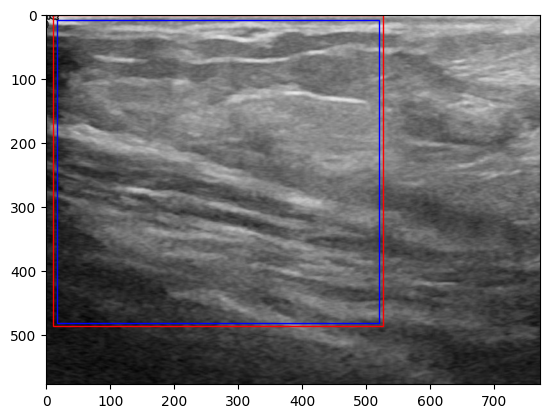

benign (292)


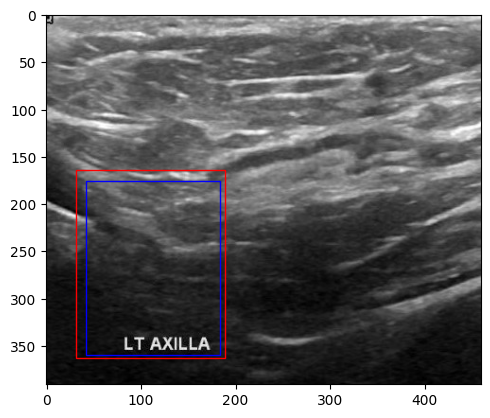

benign (110)


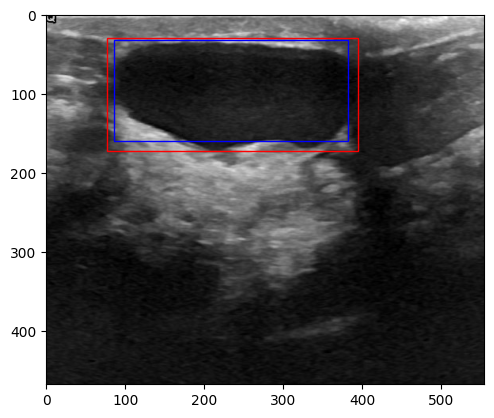

benign (86)


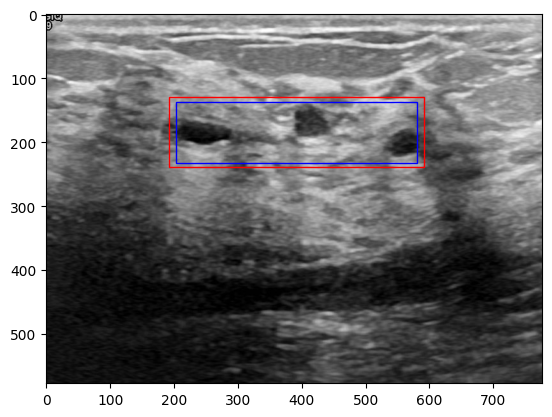

benign (249)


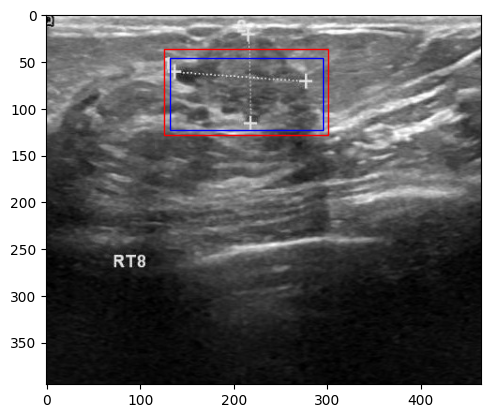

benign (157)


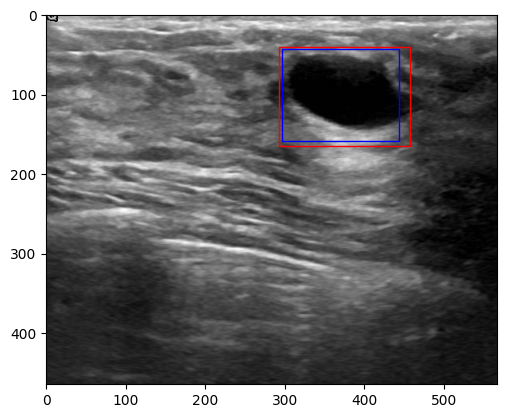

benign (73)


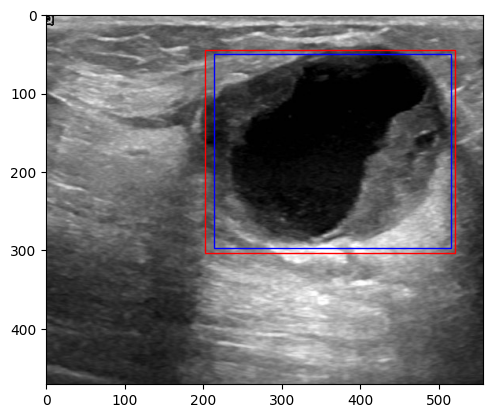

benign (206)


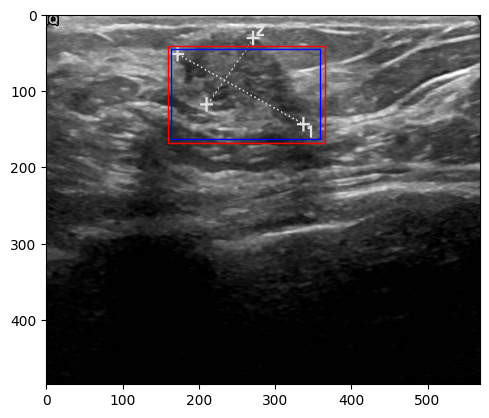

benign (257)


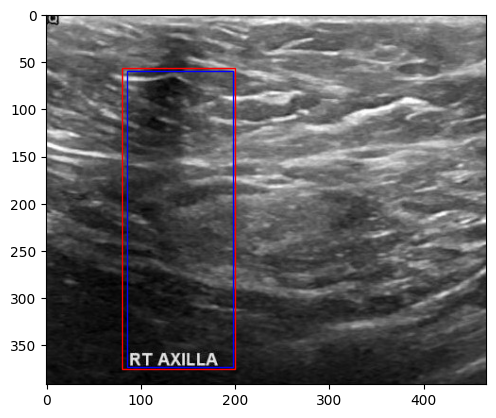

benign (286)


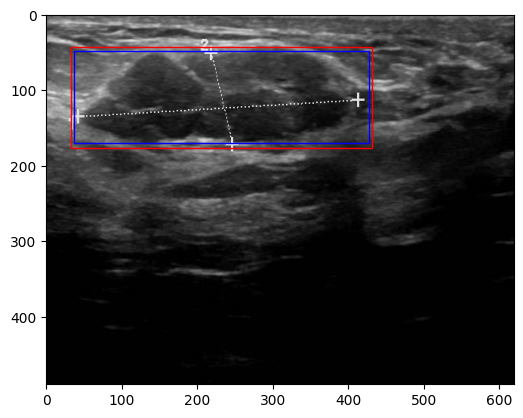

benign (392)


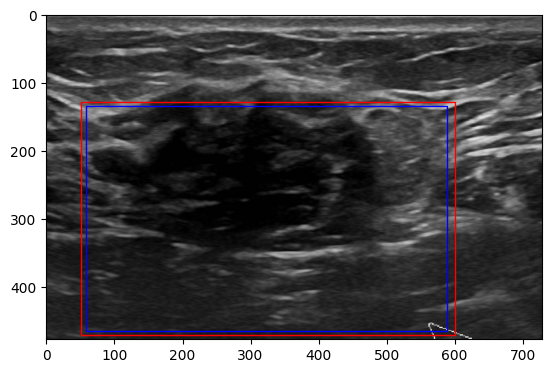

benign (97)


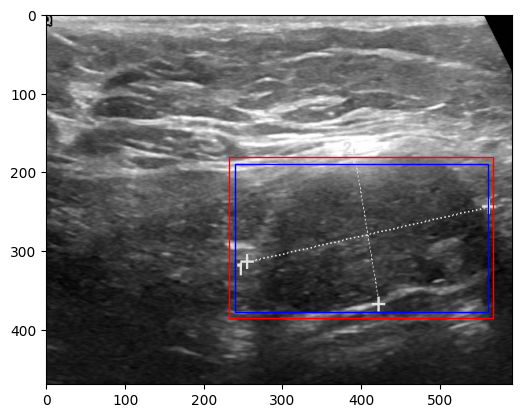

benign (119)


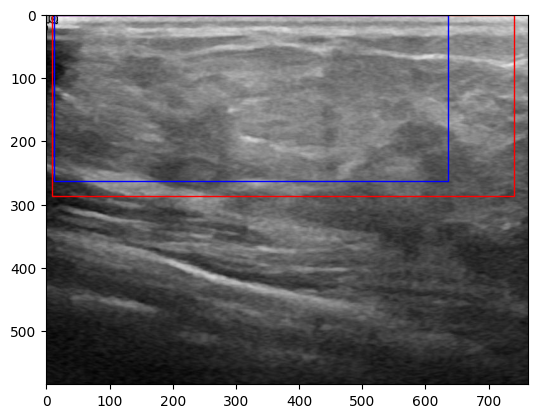

benign (291)


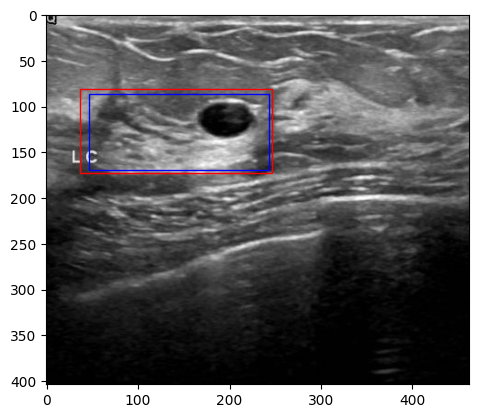

benign (195)


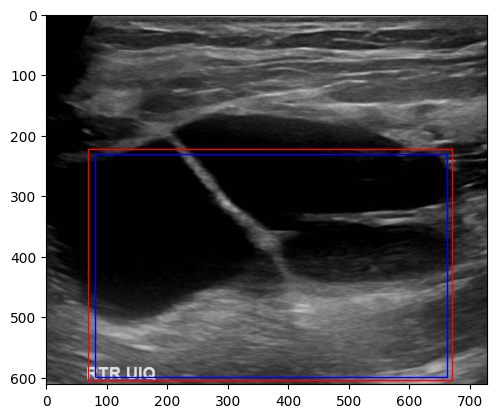

benign (244)


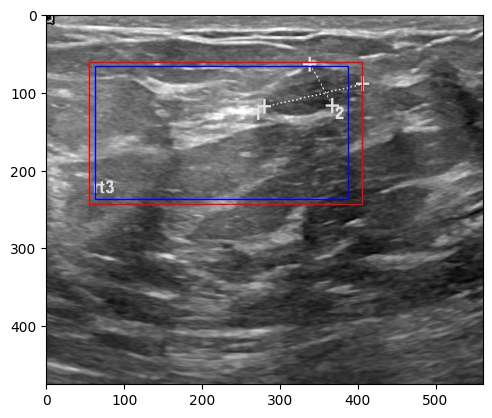

benign (366)


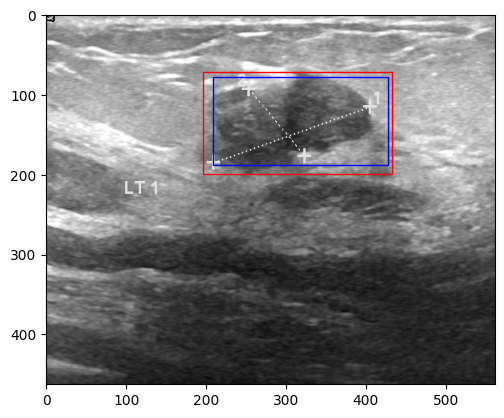

benign (134)


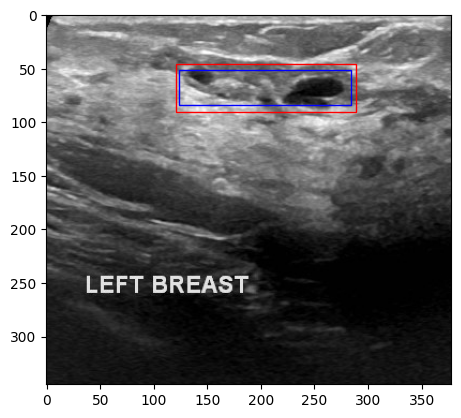

benign (196)


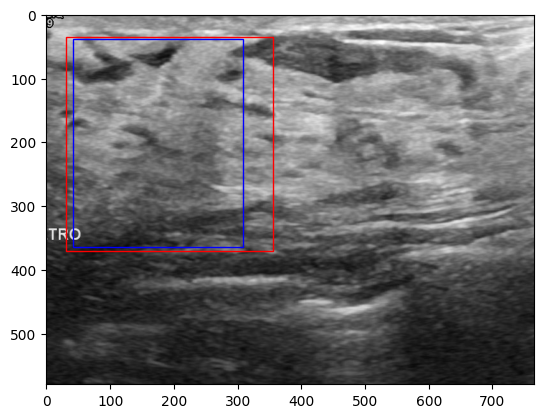

benign (393)


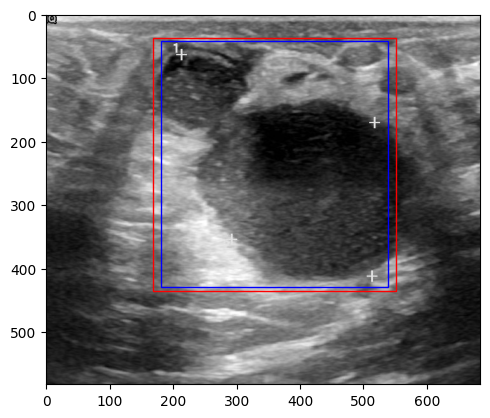

benign (95)


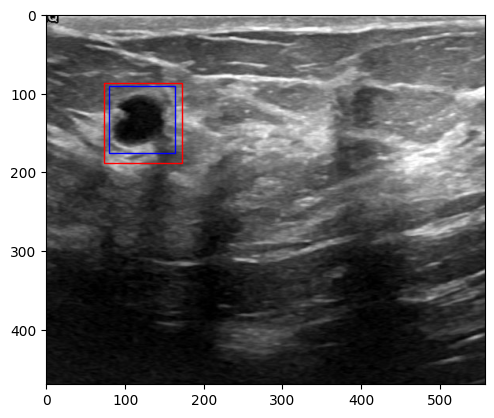

benign (94)


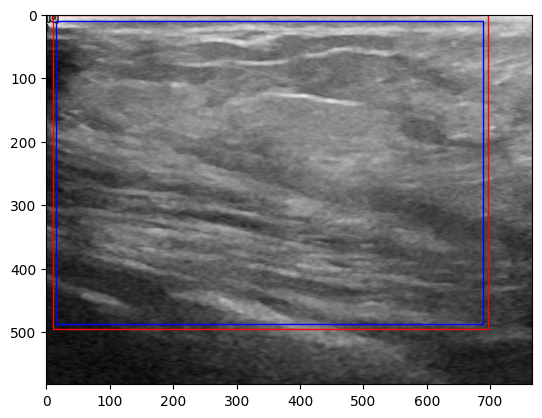

benign (315)


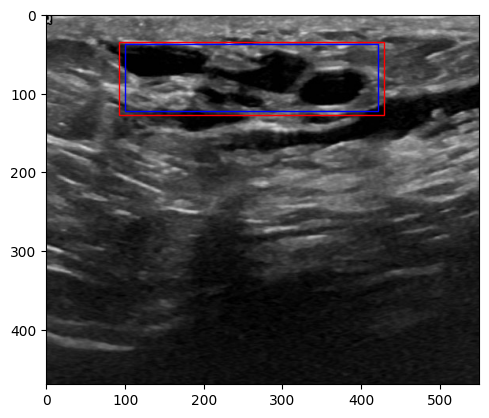

benign (148)


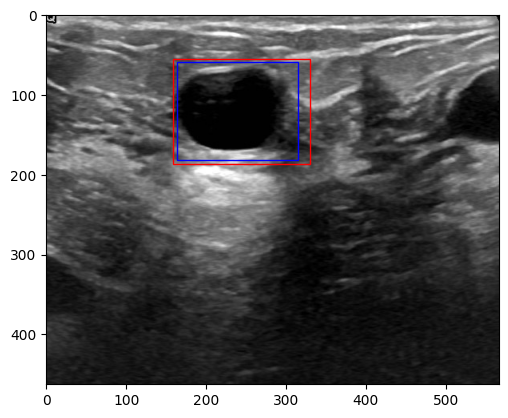

benign (203)


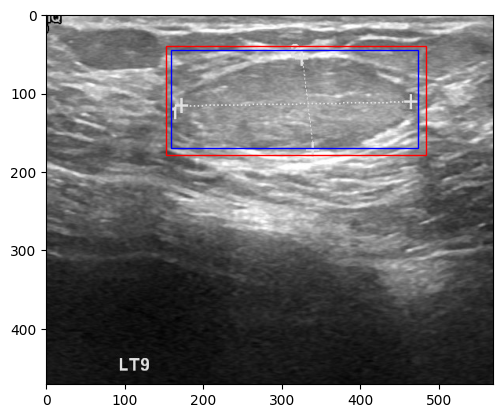

benign (397)


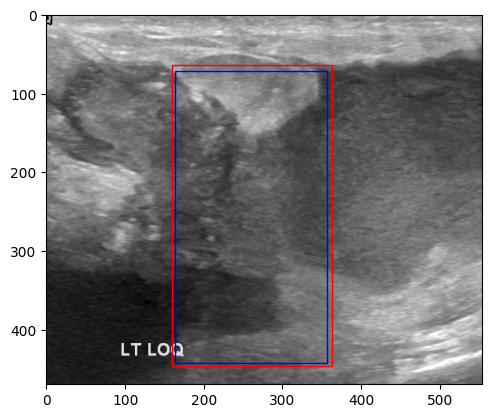

benign (107)


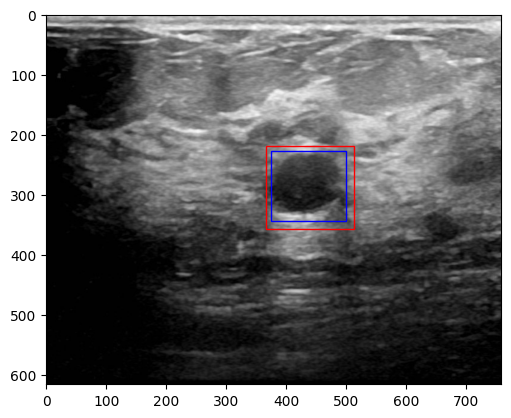

benign (79)


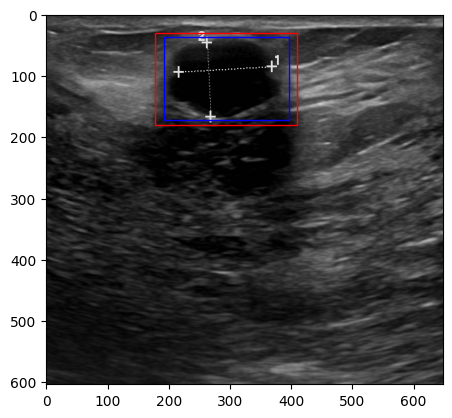

benign (297)


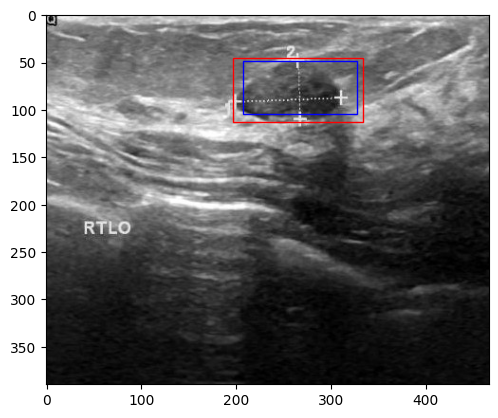

benign (217)


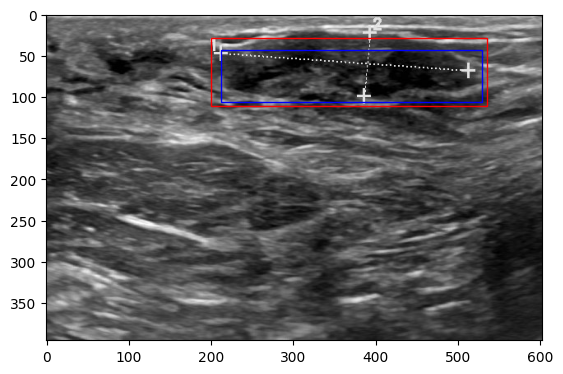

benign (387)


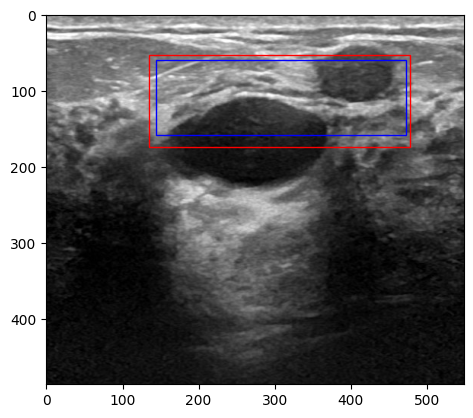

benign (33)


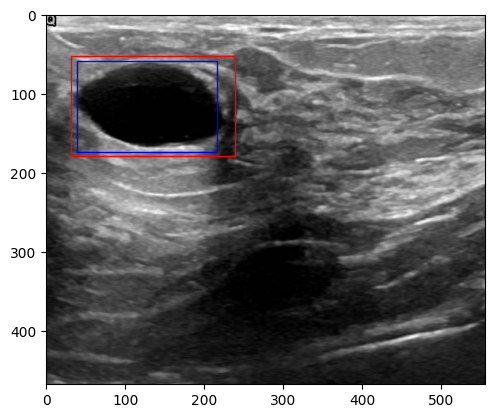

benign (390)


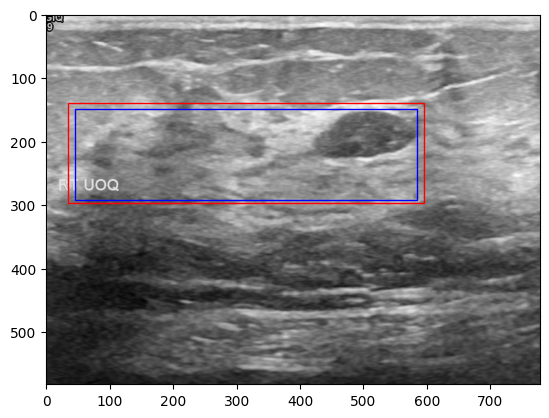

benign (321)


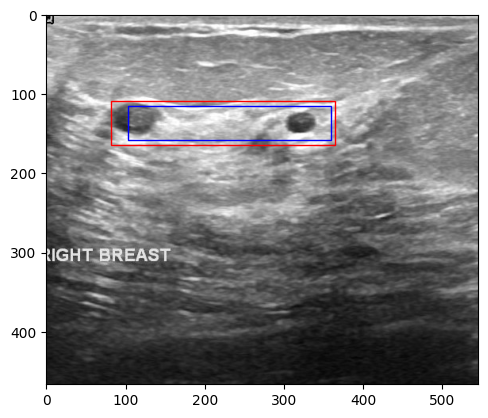

benign (172)


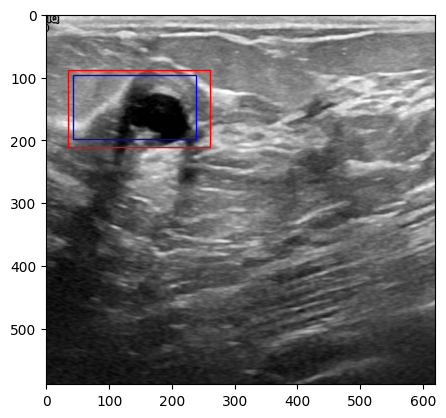

benign (426)


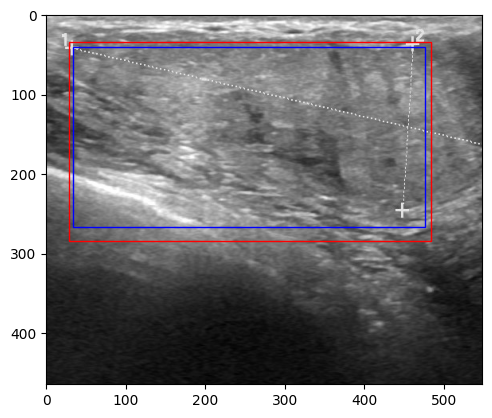

benign (87)


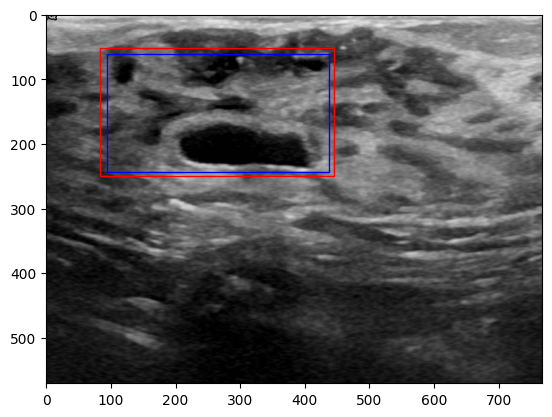

benign (229)


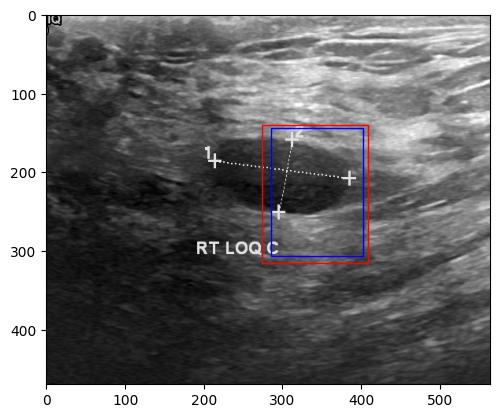

benign (93)


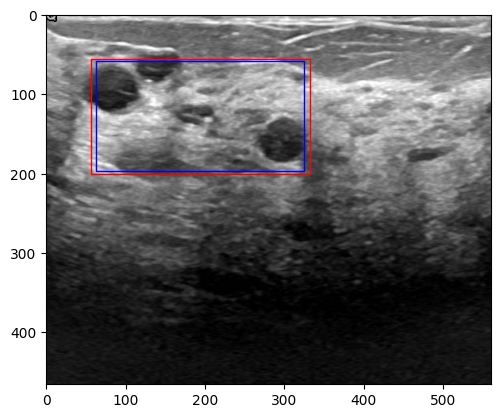

benign (319)


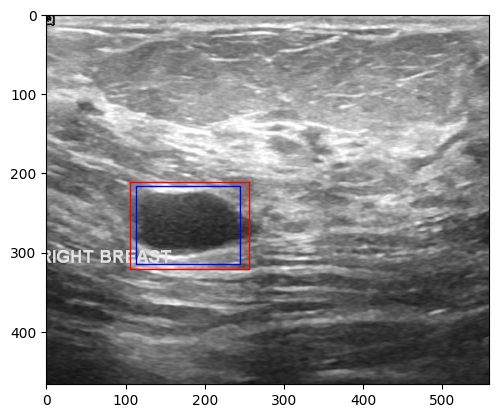

benign (141)


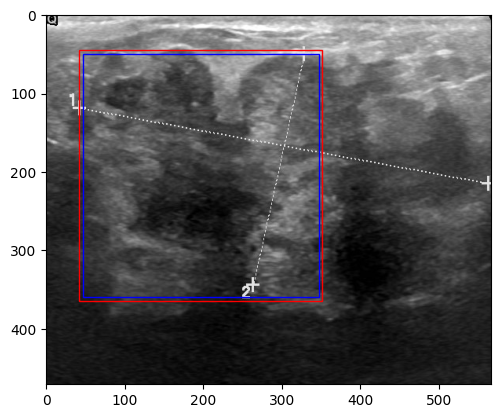

benign (336)


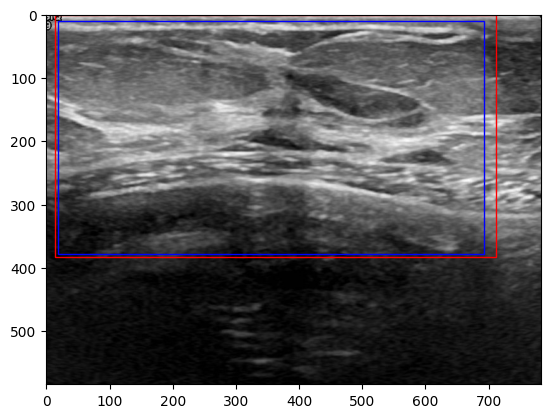

benign (326)


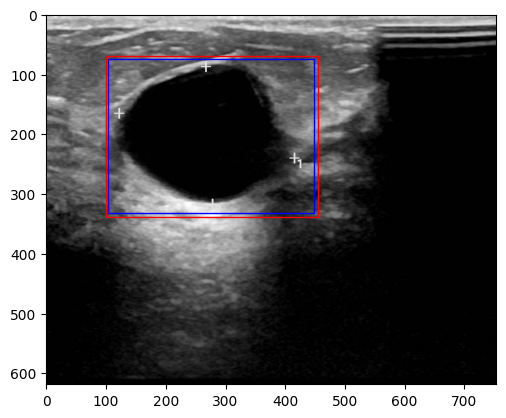

benign (68)


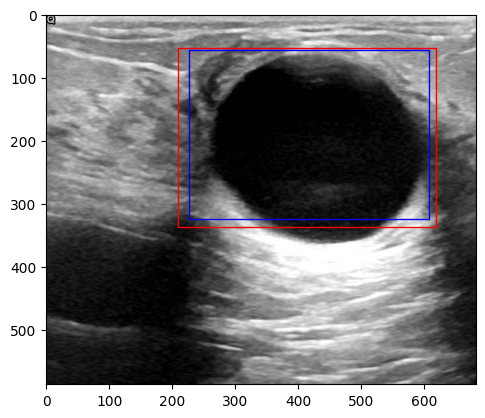

benign (108)


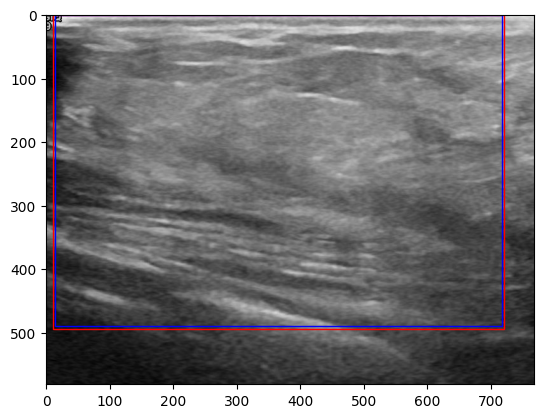

benign (55)


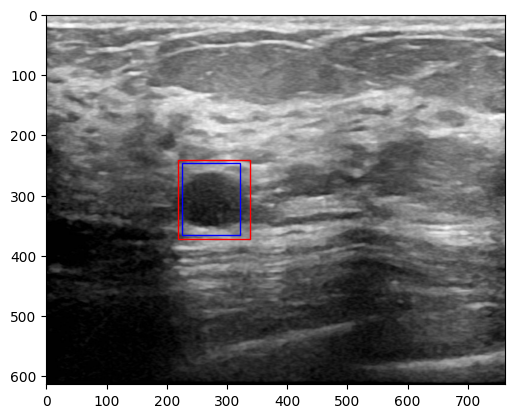

benign (379)


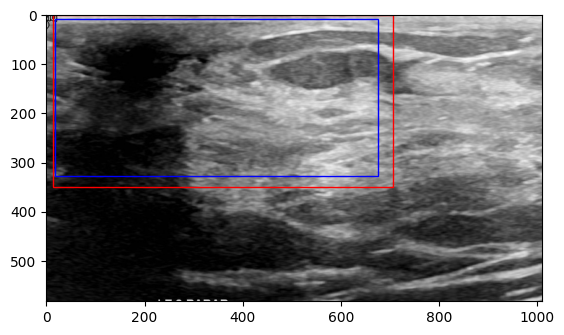

benign (64)


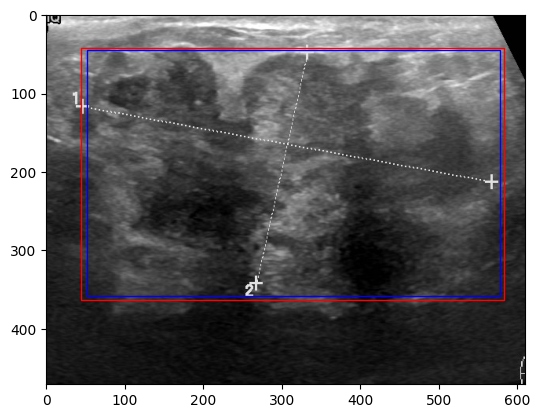

benign (131)


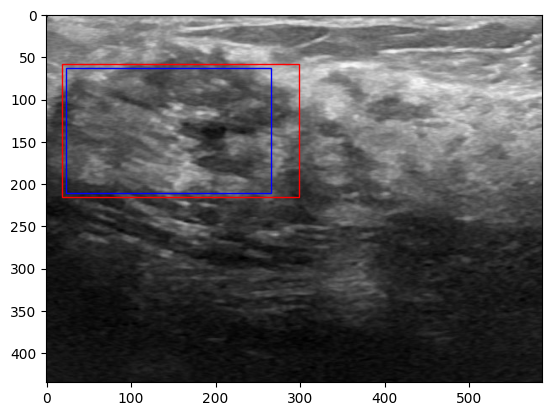

benign (362)


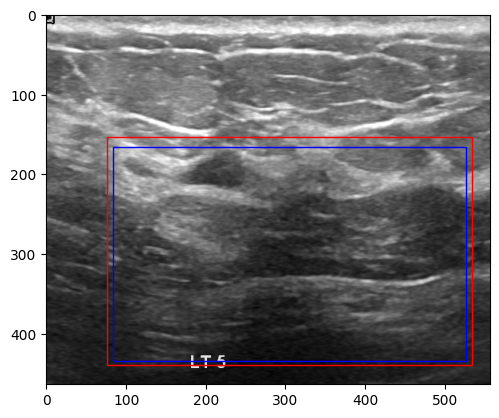

benign (256)


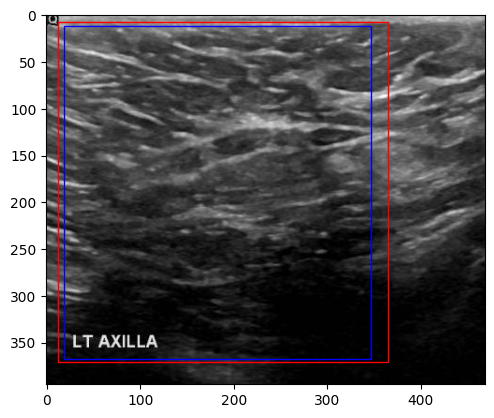

benign (410)


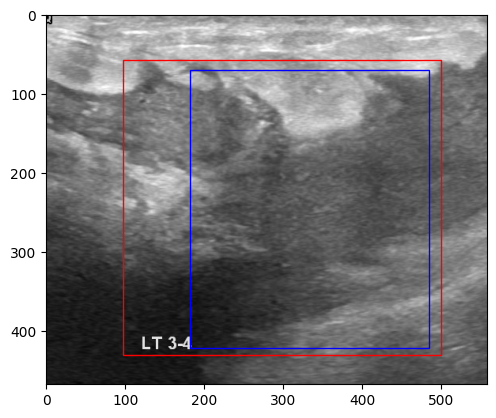

benign (424)


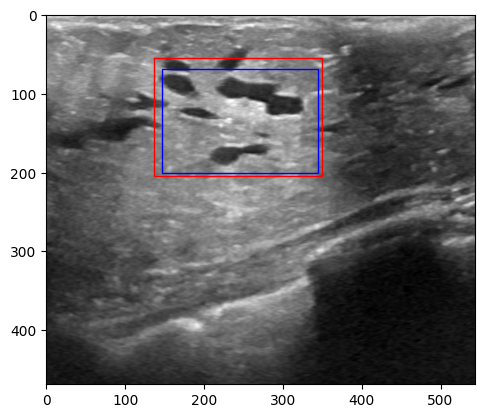

benign (123)


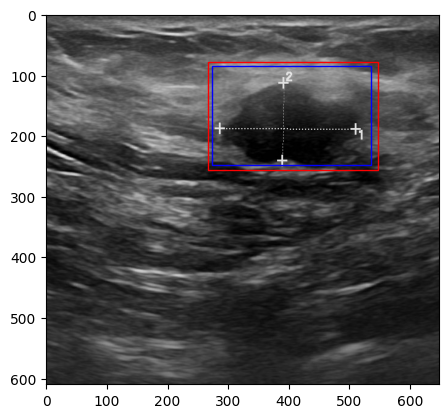

benign (370)


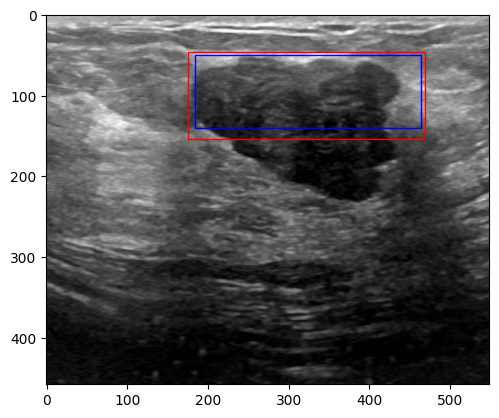

benign (77)


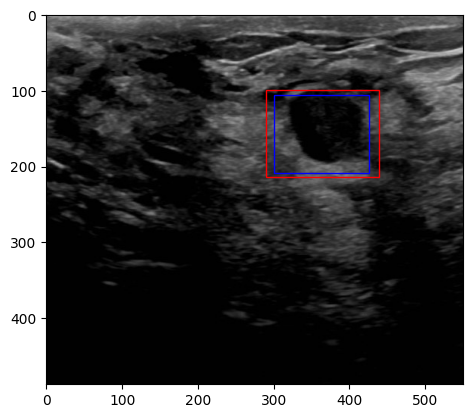

benign (303)


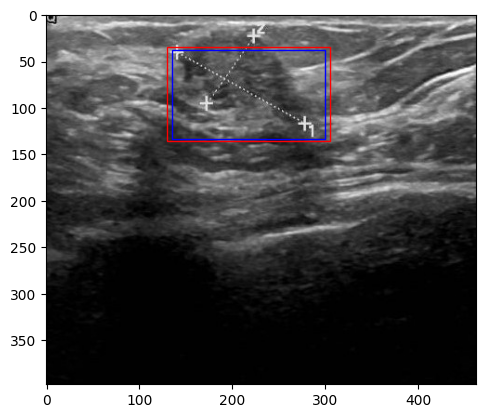

benign (158)


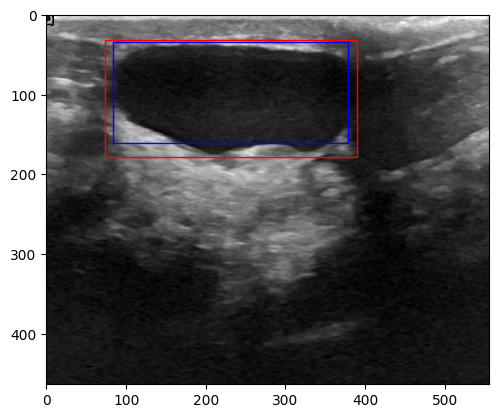

benign (282)


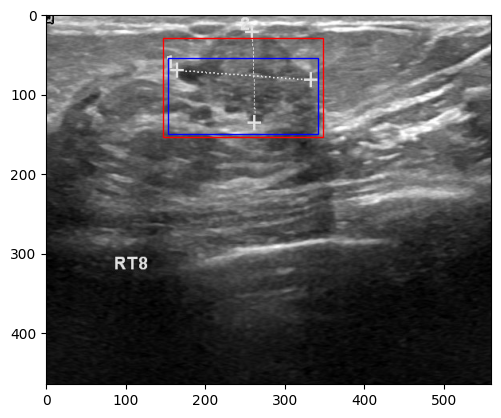

benign (13)


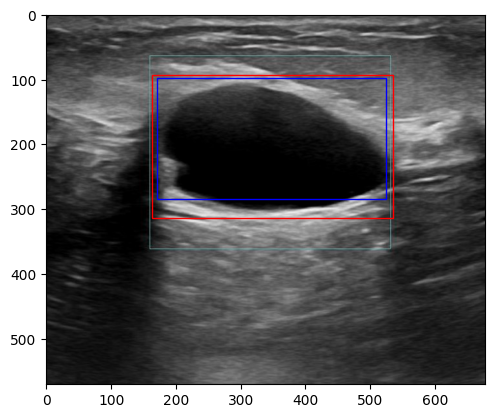

benign (173)


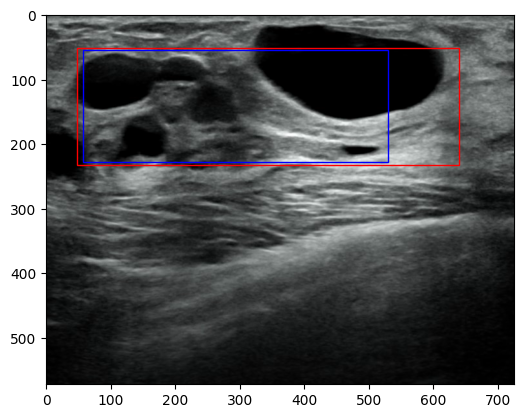

benign (27)


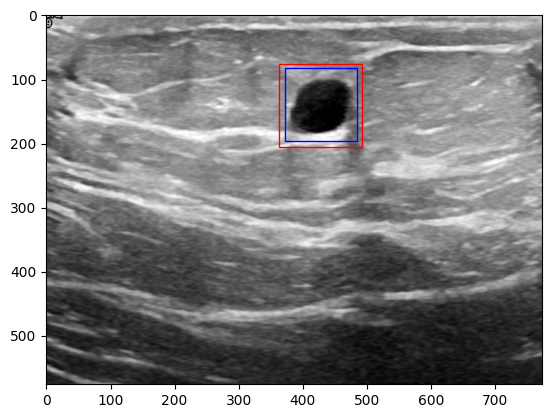

malignant (57)


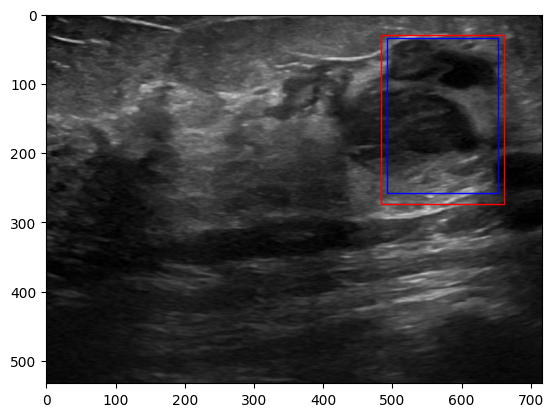

malignant (76)


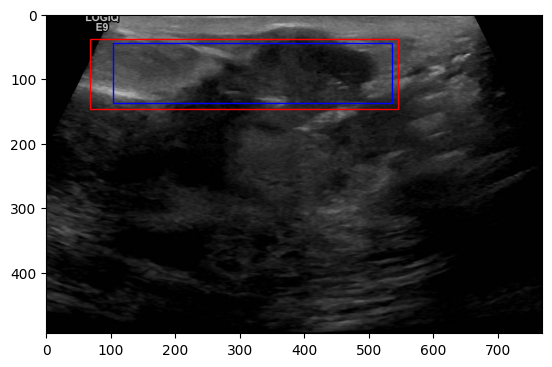

malignant (118)


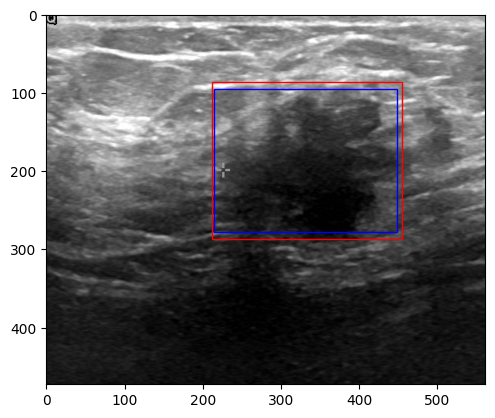

malignant (163)


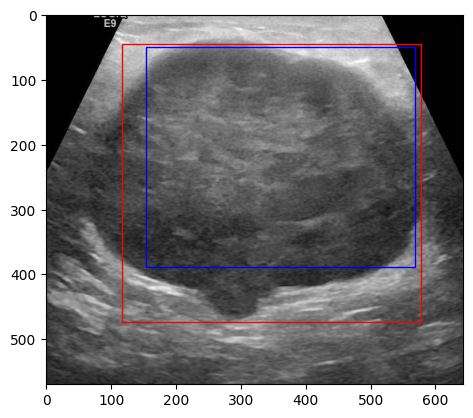

malignant (45)


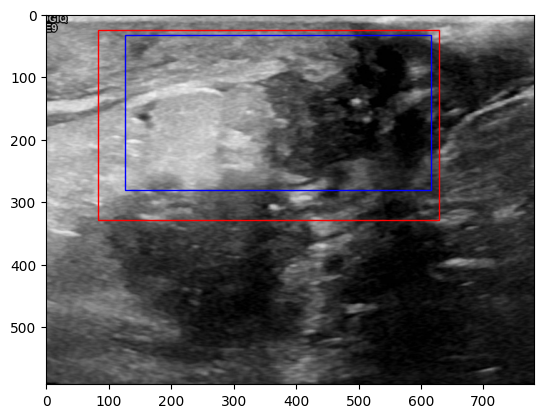

malignant (186)


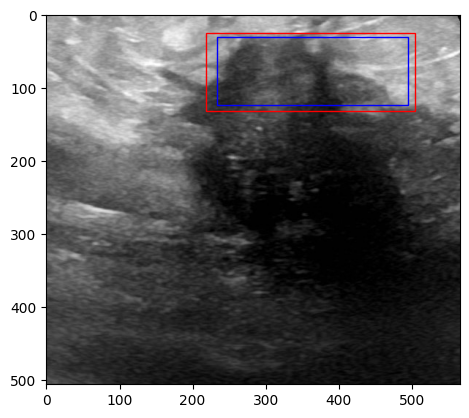

malignant (99)


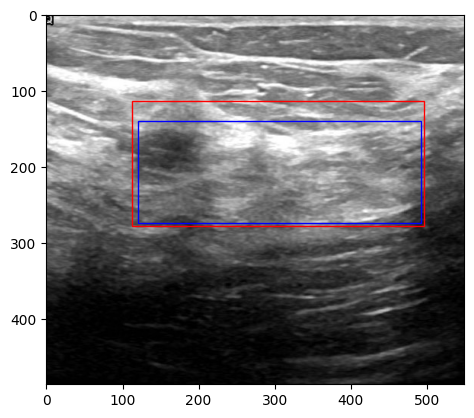

malignant (197)


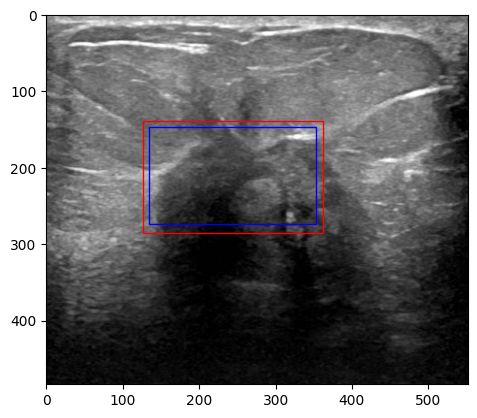

malignant (82)


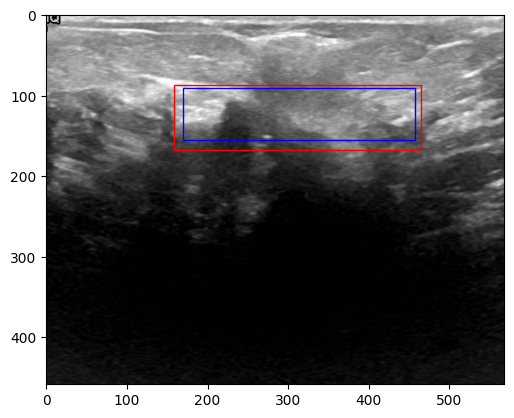

malignant (131)


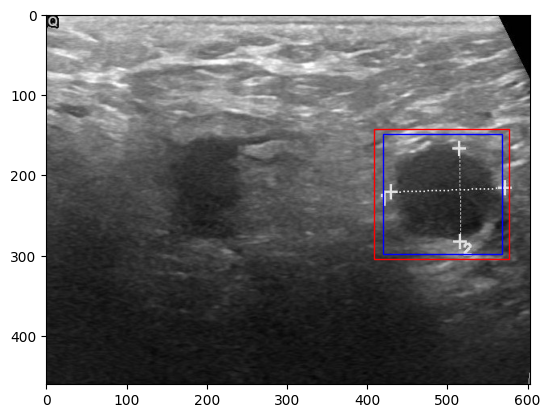

malignant (113)


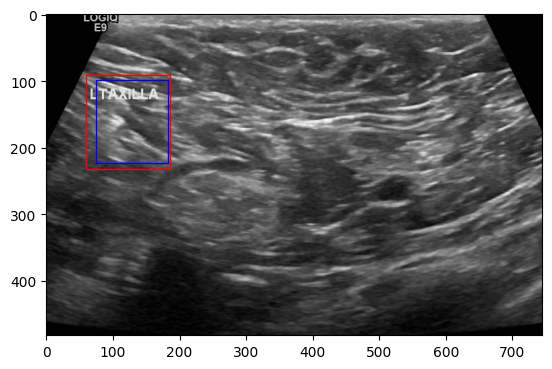

malignant (161)


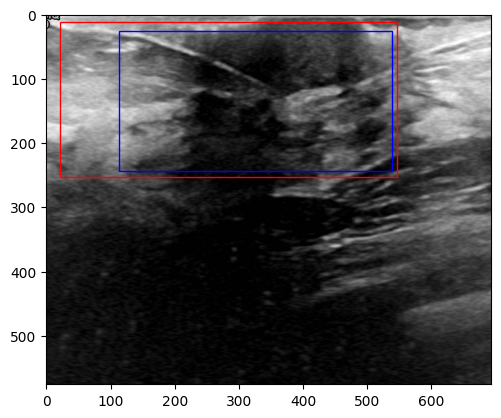

malignant (83)


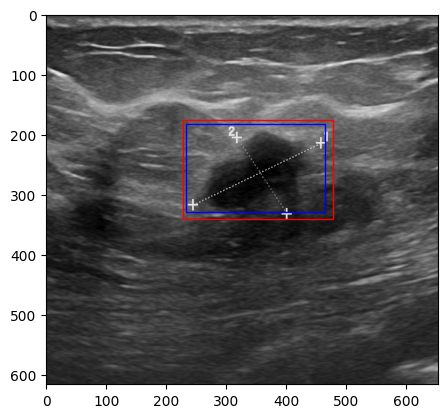

malignant (126)


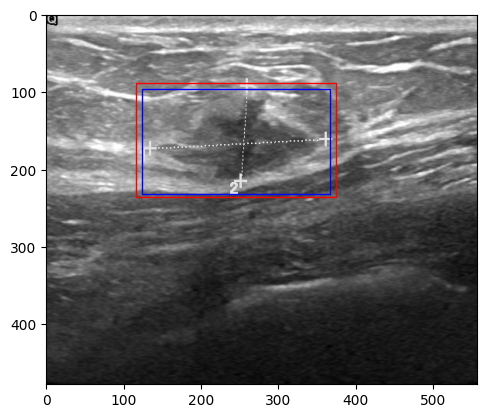

malignant (78)


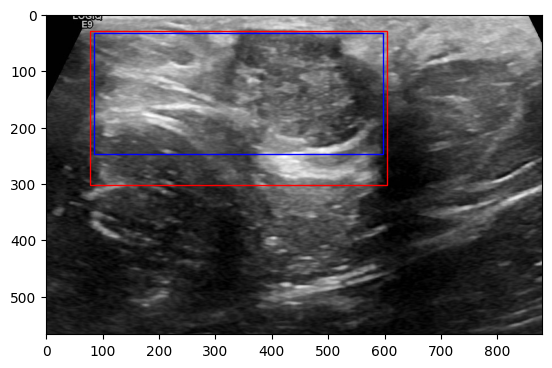

malignant (192)


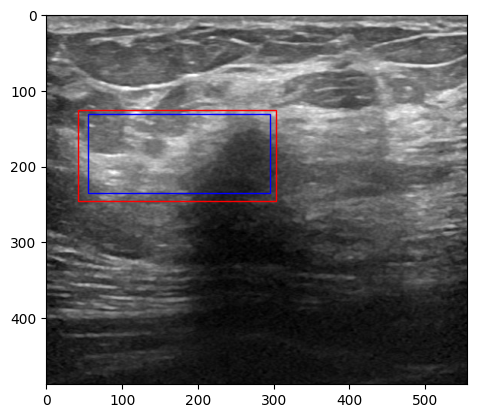

malignant (35)


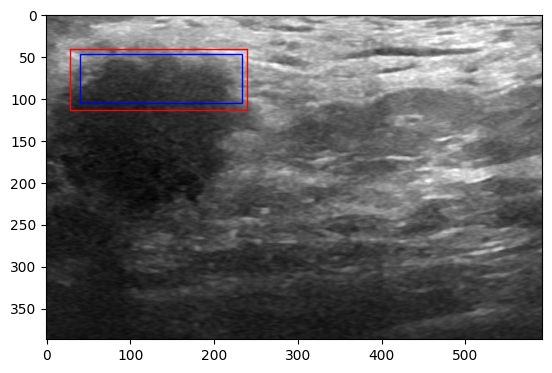

malignant (210)


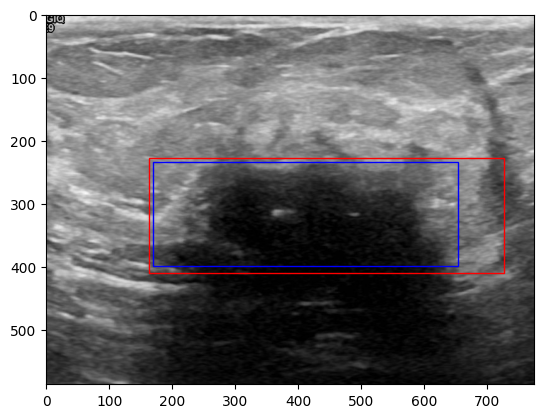

malignant (36)


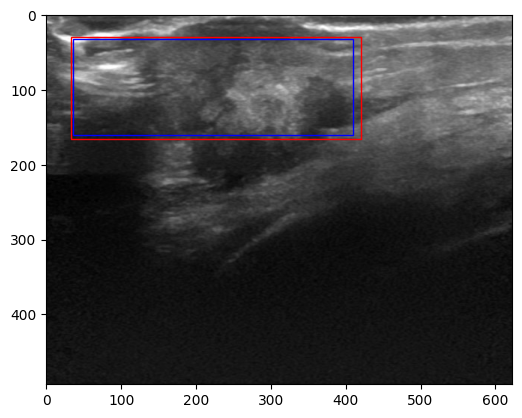

malignant (31)


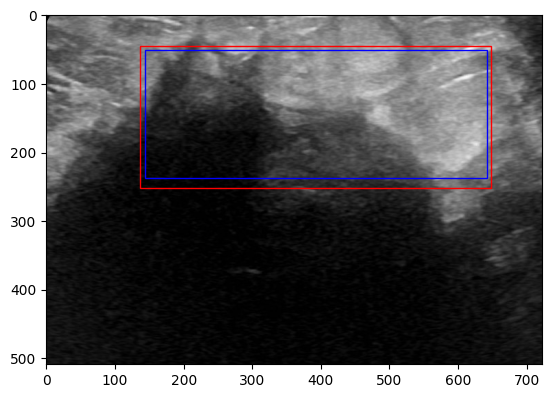

malignant (160)


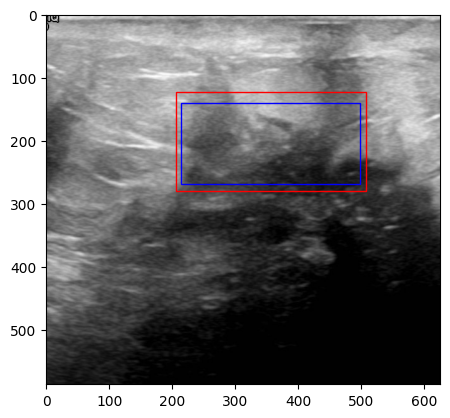

malignant (33)


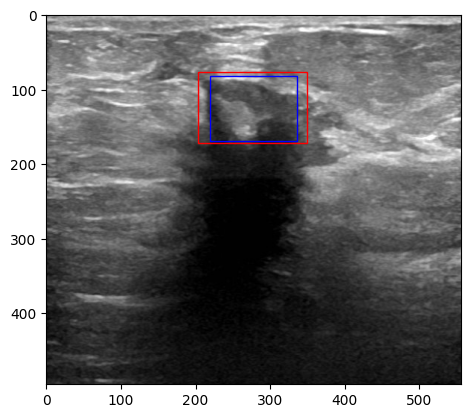

malignant (14)


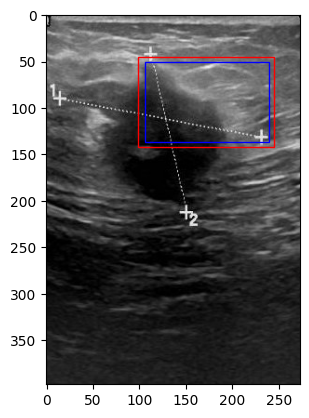

malignant (16)


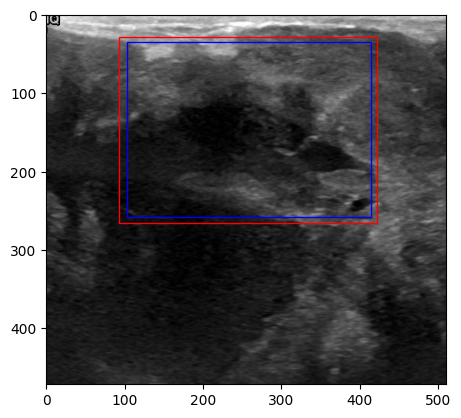

malignant (106)


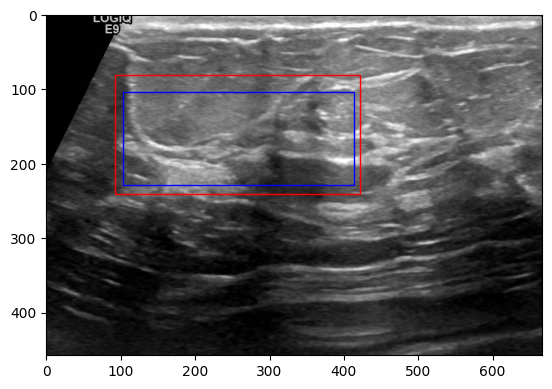

malignant (162)


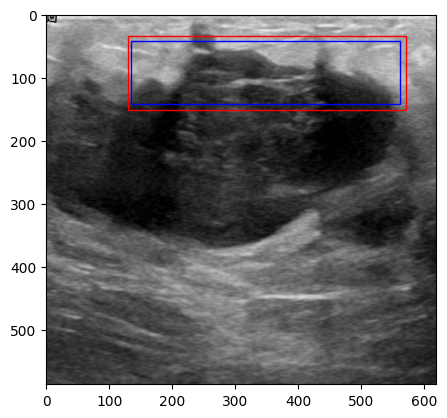

malignant (12)


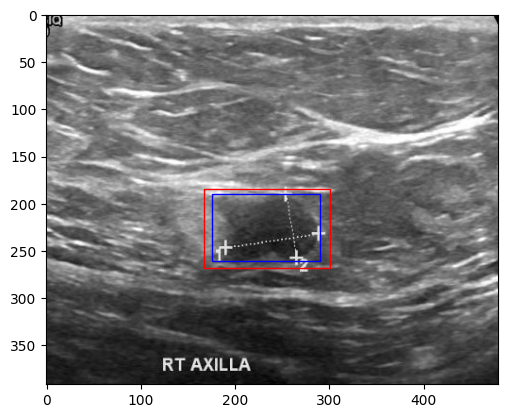

malignant (177)


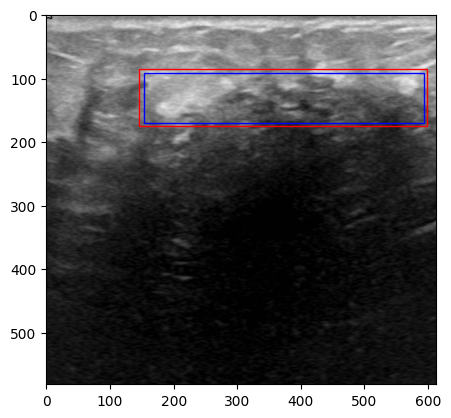

malignant (124)


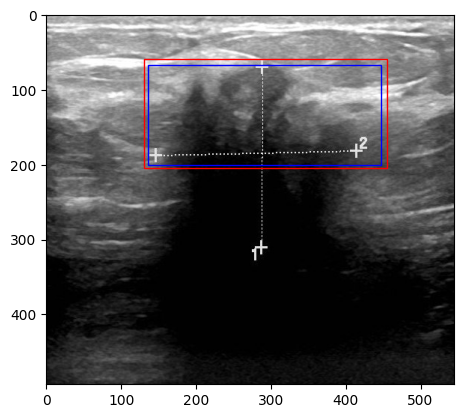

malignant (80)


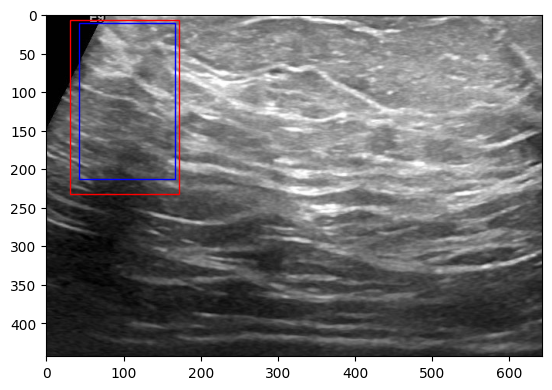

malignant (53)


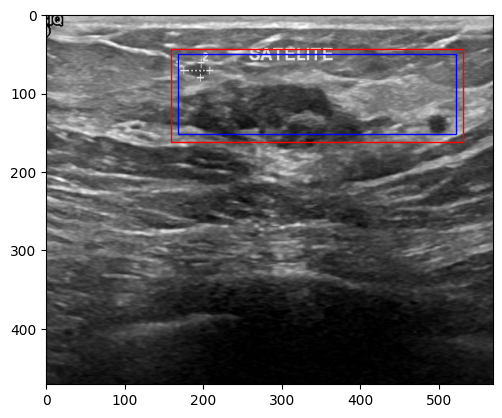

malignant (158)


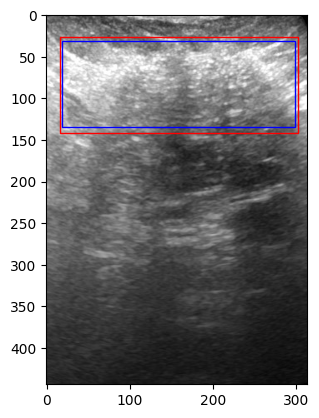

malignant (112)


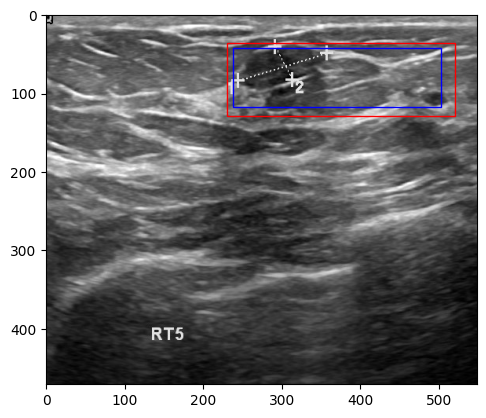

malignant (3)


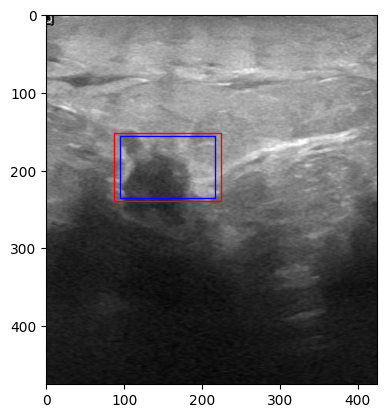

malignant (127)


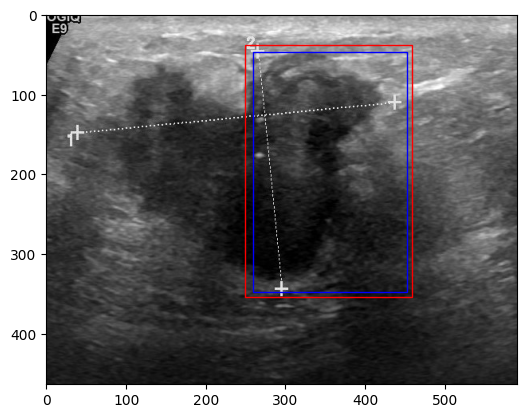

malignant (123)


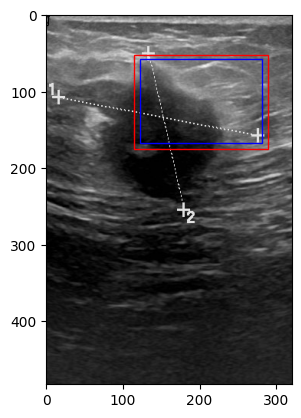

malignant (114)


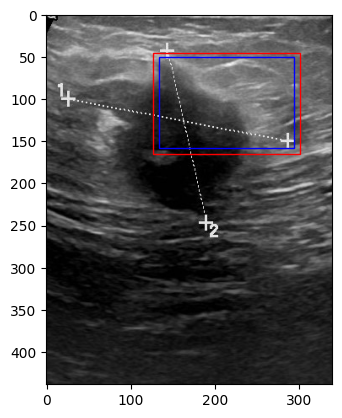

malignant (139)


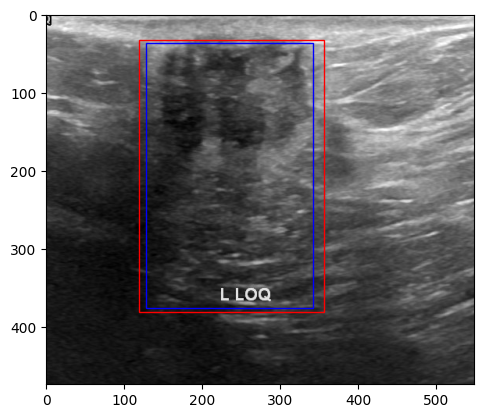

malignant (91)


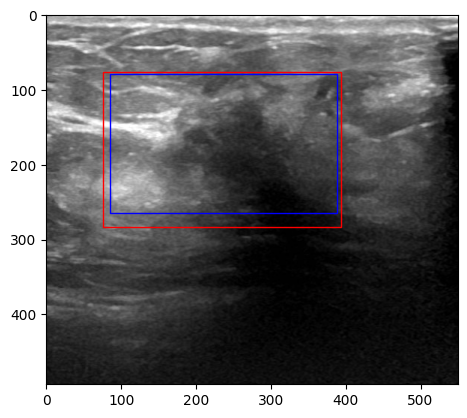

malignant (41)


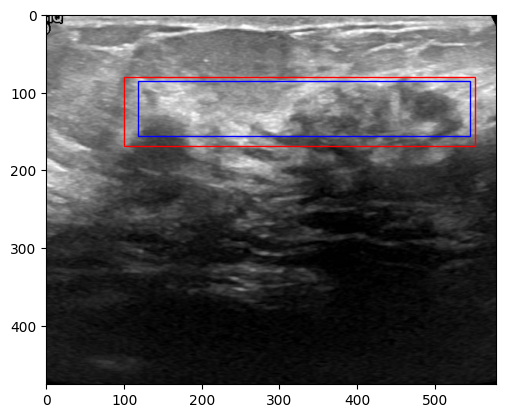

malignant (122)


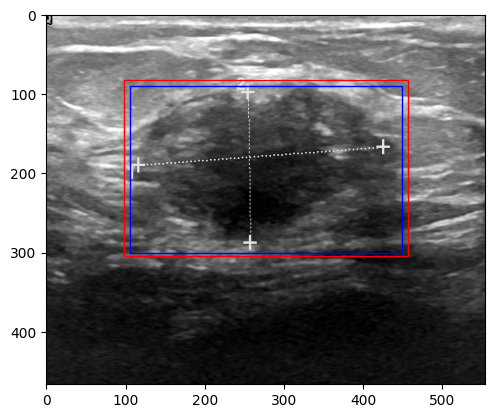

malignant (54)


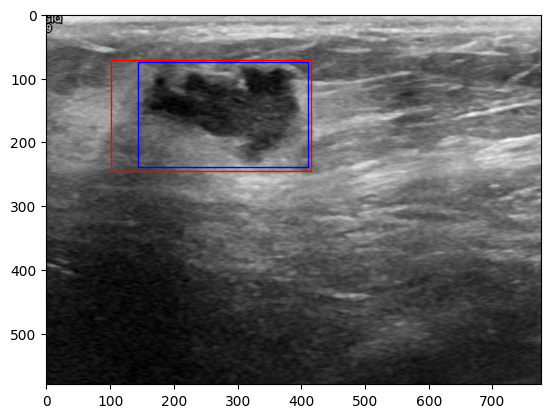

malignant (155)


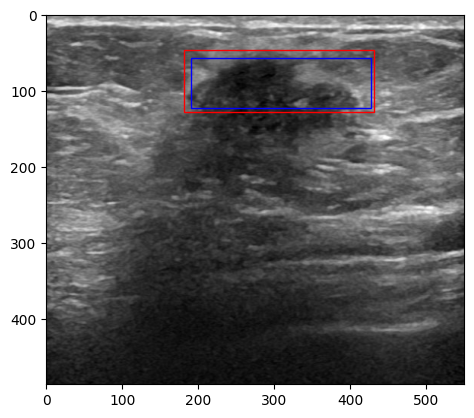

malignant (103)


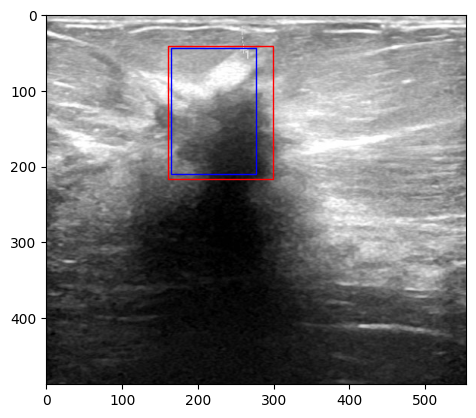

malignant (185)


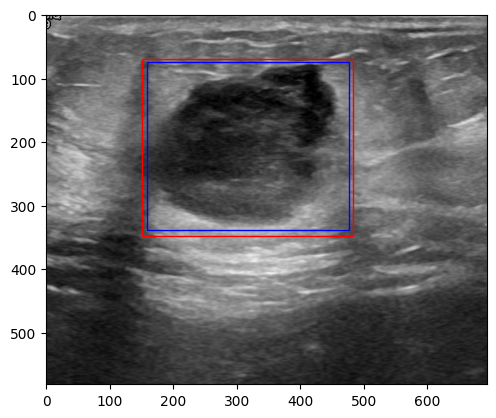

malignant (167)


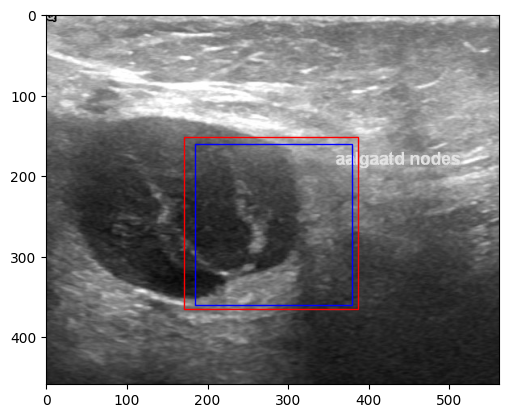

malignant (66)


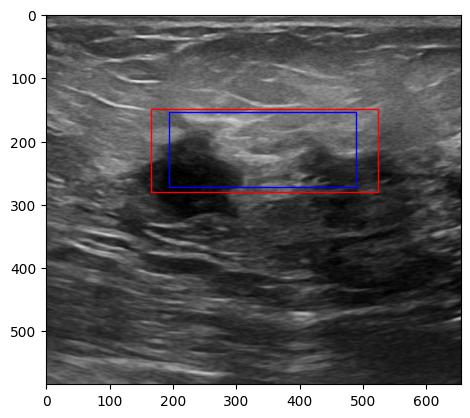

malignant (98)


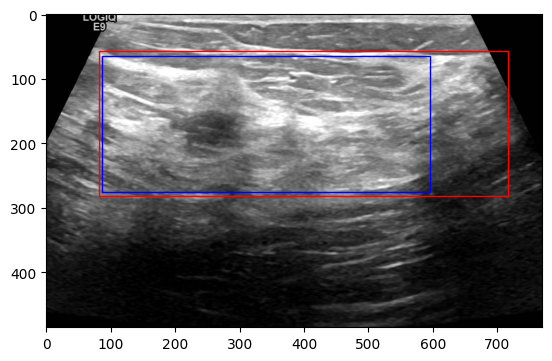

malignant (21)


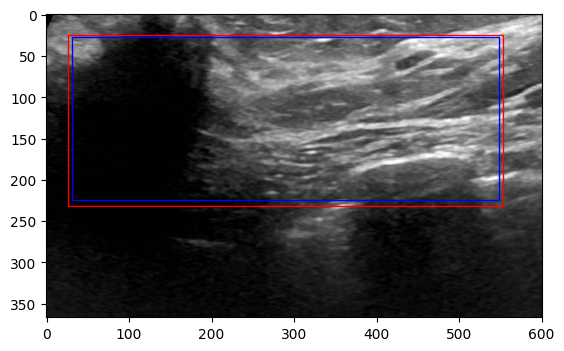

malignant (24)


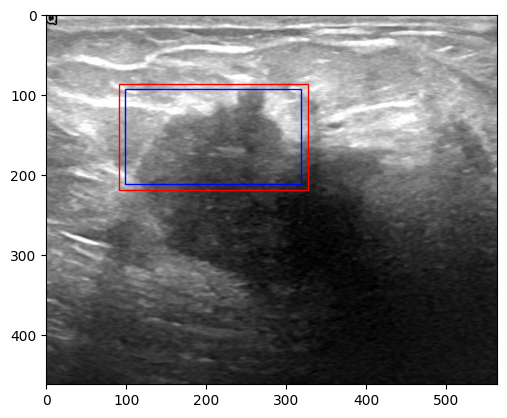

malignant (132)


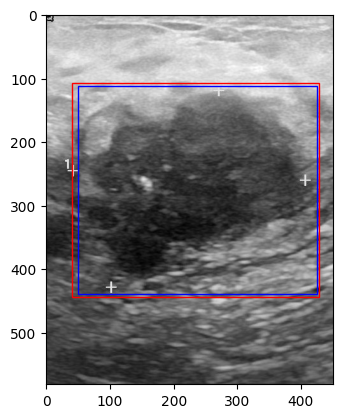

malignant (94)


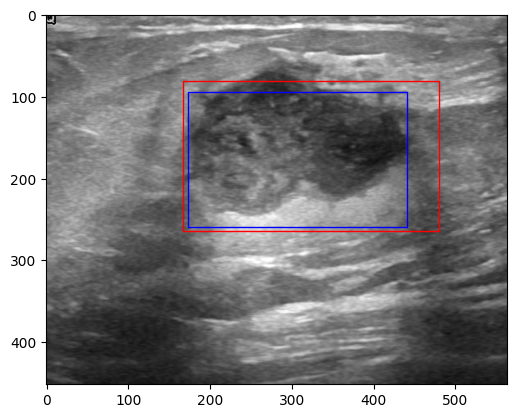

len(st) 164
['benign (111).png', 'benign (126).png', 'benign (341).png', 'benign (271).png', 'benign (186).png', 'benign (129).png', 'benign (313).png', 'benign (59).png', 'benign (378).png', 'benign (278).png', 'benign (345).png', 'benign (403).png', 'benign (275).png', 'benign (340).png', 'benign (316).png', 'benign (114).png', 'benign (406).png', 'benign (183).png', 'benign (83).png', 'benign (130).png', 'benign (161).png', 'benign (375).png', 'benign (20).png', 'benign (26).png', 'benign (40).png', 'benign (139).png', 'benign (355).png', 'benign (281).png', 'benign (101).png', 'benign (163).png', 'benign (153).png', 'benign (382).png', 'benign (380).png', 'benign (402).png', 'benign (174).png', 'benign (124).png', 'benign (222).png', 'benign (430).png', 'benign (52).png', 'benign (358).png', 'benign (2).png', 'benign (416).png', 'benign (293).png', 'benign (276).png', 'benign (34).png', 'benign (409).png', 'benign (284).png', 'benign (232).png', 'benign (23).png', 'benign (88).png'

In [3]:
# the one that cover the whole tumor #benign 126
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from help.helper import merge_rec_saveFile, boundingBoxFromGT,merge_bounding_boxes,rectangle_iou
from BUS.loadData import load
from help.helper import getPathShortName
from scipy.spatial import ConvexHull
from sklearn.cluster import KMeans

def rectangle_intersection_area(rect1, rect2):
    # Calculate the coordinates of the intersection rectangle
    x_left = max(rect1[0], rect2[0])
    y_top = max(rect1[1], rect2[1])
    x_right = min(rect1[2], rect2[2])
    y_bottom = min(rect1[3], rect2[3])

    # Check if there's a valid intersection
    if x_right < x_left or y_bottom < y_top:
        return 0

    # Calculate the intersection area
    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    return intersection_area

def rectangle_union_area(rect1, rect2):
    # Calculate the areas of the individual rectangles
    area_rect1 = (rect1[2] - rect1[0]) * (rect1[3] - rect1[1])
    area_rect2 = (rect2[2] - rect2[0]) * (rect2[3] - rect2[1])

    # Calculate the union area by adding the areas of both rectangles
    union_area = area_rect1 + area_rect2

    # Subtract the intersection area to avoid double-counting
    union_area -= rectangle_intersection_area(rect1, rect2)
    return union_area
def rectangle_iou(rect1, rect2):
    """
    # top-left and bottom-right coordinates (x1, y1, x2, y2)
    """
    intersection_area = rectangle_intersection_area(rect1, rect2)
    union_area = rectangle_union_area(rect1, rect2)

    # Handle the case of division by zero to avoid errors
    if union_area == 0:
        return 0

    iou = intersection_area / union_area
    return iou

def readFromSet_list(file_path = '/home/lintzuh@kean.edu/BUS/AMR/record/ROI_FULLSET.txt'):
    import re
    import sys
   
    
    sys.path.append('/home/lintzuh@kean.edu/BUS/mean-teacher-medical-imaging/code')
    def getFullPathName(dataRoot, shortName):
        # input: benign (126)
        import os
        if shortName[0] == 'b':
            type = 'benign'
        elif shortName[0] == 'm':
            type = 'malignant'
        else:
            type = 'normal'

        Fp = os.path.join(dataRoot, type, shortName+'.png')
        return Fp
    imageName = []
    imageNameRec=[]
    dataroot = '/home/lintzuh@kean.edu/BUS/data/Dataset_BUSI_with_GT'

    with open(file_path, 'r') as file:
        next(file)

        for line in file:
            # Regular expression pattern to match the required fields
            pattern = r'([^,]+ \(\d+\)), \((\d+, \d+, \d+, \d+)\)'

            match = re.match(pattern, line)

            if match:
                filename = match.group(1)
                coordinates = tuple(map(int, match.group(2).split(', ')))
                


                fullFileName =getFullPathName(dataroot, filename)
                imageName.append(fullFileName)
                imageNameRec.append(coordinates)
            else:
                print('dangerous, when reading file')
    return imageName, imageNameRec


def plot_histogram(image):
    """Plot the histogram of the given image."""
    plt.hist(image.ravel(), bins=256, range=[0, 255])
    plt.title('Histogram of the Image')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.show()

def count_pixels_in_range(image, min_value, max_value):
    """Count the number of pixels in the specified range."""
    return np.sum((image >= min_value) & (image <= max_value))



def find_points_in_range(image, min_value, max_value):
    """Find the coordinates of pixels in the specified range."""
    y_coords, x_coords = np.where((image >= min_value) & (image <= max_value))
    return np.column_stack((x_coords, y_coords))


def compute_convex_hull(points):
    """Compute the convex hull of a set of points."""
    return ConvexHull(points)

def plot_convex_hull(image, hull, points):
    """Plot the image and the convex hull."""
    plt.imshow(image, cmap='gray')
    for simplex in hull.simplices:
        plt.plot(points[simplex, 0], points[simplex, 1], 'r-')
    plt.show()


def find_percent_threshold(image, percent):
    """
    Find a threshold value in the image such that the number of pixels above this 
    threshold is 20% of the total number of pixels.

    :param image: The processed image.
    :return: The threshold value.
    """
    # Calculate histogram
    hist, bins = np.histogram(image, bins=256, range=(0, 255))

    # Compute the cumulative sum from the end
    cum_sum = np.cumsum(hist[::-1])[::-1]

    # Total number of pixels
    total_pixels = image.size

    # Find the threshold index
    threshold_index = np.where(cum_sum <= total_pixels * percent)[0][0]

    # Corresponding bin value
    threshold_value = bins[threshold_index]

    return threshold_value

def plot_convex_hulls(image, points1, points2, color1='r', color2='b'):
    """
    Plot the image and the convex hulls for two sets of points.

    :param image: The image on which to plot the convex hulls.
    :param points1: The first set of points.
    :param points2: The second set of points.
    :param color1: The color for the first convex hull.
    :param color2: The color for the second convex hull.
    """
    plt.imshow(image, cmap='gray')

    # Compute and plot the first convex hull
    if len(points1) > 2:  # Convex hull requires at least 3 points
        hull1 = ConvexHull(points1)
        for simplex in hull1.simplices:
            # x = points1[simplex, 0]
            # y = points1[simplex, 1]
            plt.plot(points1[simplex, 0], points1[simplex, 1], color1 + '-')

    # Compute and plot the second convex hull
    if len(points2) > 2:  # Convex hull requires at least 3 points
        hull2 = ConvexHull(points2)
        for simplex in hull2.simplices:
            plt.plot(points2[simplex, 0], points2[simplex, 1], color2 + '-')

    plt.show()


def find_extreme_points(points):
    if len(points) > 2:  # Convex hull requires at least 3 points
        hull = ConvexHull(points)

        # Extract the hull points
        hull_points = points[hull.vertices, :]

        # Find the leftmost, rightmost, top, and bottom points
        x_leftMost = np.min(hull_points[:, 0])
        x_rightMost = np.max(hull_points[:, 0])
        y_top = np.min(hull_points[:, 1])
        y_bottom = np.max(hull_points[:, 1])

        return x_leftMost, x_rightMost, y_top, y_bottom

    else:
        return None, None, None, None
    




def plot_with_bounding_box(image, points, bounding_box):
    import matplotlib.pyplot as plt
    from matplotlib.patches import Rectangle
    """
    Plot the image with a bounding box.

    :param image: The image to plot.
    :param points: The points used to create the bounding box.
    :param bounding_box: The (x_left, x_right, y_top, y_bottom) bounding box coordinates.
    """
    x_left, x_right, y_top, y_bottom = bounding_box

    # Create the figure and axis
    fig, ax = plt.subplots()
    ax.imshow(image, cmap='gray')

    # Draw the points (optional)
    # ax.scatter(points[:, 0], points[:, 1], c='red')

    # Draw the bounding box
    # Note: Rectangle takes (x, y) of the lower-left corner, width, and height
    rect = Rectangle((x_left, y_top), x_right - x_left, y_bottom - y_top,
                     edgecolor='blue', facecolor='none')
    ax.add_patch(rect)

    plt.show()


def plot_with_bounding_boxes(image, points1, points2, bounding_box1, bounding_box2):
    import matplotlib.pyplot as plt
    from matplotlib.patches import Rectangle

    x_left1, x_right1, y_top1, y_bottom1 = bounding_box1
    x_left2, x_right2, y_top2, y_bottom2 = bounding_box2

    # Create the figure and axis
    fig, ax = plt.subplots()
    ax.imshow(image, cmap='gray')

    # Draw the first bounding box
    rect1 = Rectangle((x_left1, y_top1), x_right1 - x_left1, y_bottom1 - y_top1,
                     edgecolor='red', facecolor='none')
    ax.add_patch(rect1)

    # Draw the second bounding box
    rect2 = Rectangle((x_left2, y_top2), x_right2 - x_left2, y_bottom2 - y_top2,
                     edgecolor='blue', facecolor='none')
    ax.add_patch(rect2)

    plt.show()



    
# def getBoundingBox(camFolder, filename):
#     img_name, type = getPathShortName(filename)
#     print(img_name[:-4])
#     image = cv2.imread(filename)
#     cam_path=os.path.join(camFolder, type, img_name[:-4] + '.npy')

#     loaded_data = np.load(cam_path,allow_pickle=True).item()
#     cam = loaded_data['high_res']
#     cam = (cam - cam.min()) / (cam.max() - cam.min()) * 255
#     cam = np.uint8(cam)
#     cam = cam.reshape((image.shape[0], image.shape[1]))

#     num=find_percent_threshold(cam, 0.025)
#     # print('num', num)
#     s1=count_pixels_in_range(cam, num, 255)
#     print('s1',s1)
#     points1 = find_points_in_range(cam, num, 250)

def determine_optimal_clusters(points, max_clusters=10):
    wcss = []
    for i in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
        kmeans.fit(points)
        wcss.append(kmeans.inertia_)

    # Plotting the results onto a line graph to observe 'The elbow'
    plt.plot(range(1, max_clusters + 1), wcss, marker='o')
    plt.title('Elbow Method')
    plt.xlabel('Number of clusters')
    plt.ylabel('WCSS')
    plt.show()

    # Ask user to determine the elbow point
    print("Please observe the plot and enter the number of clusters at the elbow point.")
    n_clusters = int(input("Enter the optimal number of clusters: "))
    return n_clusters

def plot_clustered_convex_hulls(image, points, n_clusters, colors):
    # Apply K-means clustering with the determined number of clusters
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(points)
    labels = kmeans.labels_

    plt.imshow(image, cmap='gray')

    # Compute and plot the convex hull for each cluster
    for i in range(n_clusters):
        cluster_points = points[labels == i]
        if len(cluster_points) > 2:  # Convex hull requires at least 3 points
            hull = ConvexHull(cluster_points)
            for simplex in hull.simplices:
                plt.plot(cluster_points[simplex, 0], cluster_points[simplex, 1], colors[i] + '-')

    plt.show()


def getDot(camFolder, filename):
    """
    use the file in the camfolder to visualize in the same picture
    return pic
    """

    img_name, type = getPathShortName(filename)
    # print(img_name[:-4])
    image = cv2.imread(filename)
    cam_path=os.path.join(camFolder, type, img_name[:-4] + '.npy')

    loaded_data = np.load(cam_path,allow_pickle=True).item()
    cam = loaded_data['high_res']
    cam = (cam - cam.min()) / (cam.max() - cam.min()) * 255
    cam = np.uint8(cam)
    cam = cam.reshape((image.shape[0], image.shape[1]))


    # version2
    # num=find_percent_threshold(cam, 0.025)
    # # print('num', num)
    # # s=count_pixels_in_range(cam, num, 255)
    # # print('s',s)
    # points1 = find_points_in_range(cam, num, 250)

    # max_clusters = 3
    # n_clusters = determine_optimal_clusters(points1, max_clusters)
    # colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k'] # Extend this list based on max_clusters
    # plot_clustered_convex_hulls(image, points1, n_clusters, colors[:n_clusters])


    # version 1
    # plot_histogram(cam)
    num=find_percent_threshold(cam, 0.025)
    # print('num', num)
    s1=count_pixels_in_range(cam, num, 255)
    # print('s1',s1)
    points1 = find_points_in_range(cam, num, 250)
        # Compute the convex hull
    # hull = compute_convex_hull(points)
    # Plot the image and the convex hull
    # plot_convex_hull(image, hull, points)


    bounding_box1 = find_extreme_points(points1)
    # plot_with_bounding_box(image, points1, bounding_box1)






    num2=find_percent_threshold(cam, 0.01)
    # print('num', num)
    s2=count_pixels_in_range(cam, num2, 255)
    # print('s2',s2)
    points2 = find_points_in_range(cam, num2, 250)
    bounding_box2 = find_extreme_points(points2)
    # plot_with_bounding_box(image, points2, bounding_box2)


    # plot_with_bounding_boxes(image, points1 ,points2, bounding_box1,bounding_box2)

    # plot_convex_hulls(image, points1, points2)

    x1_leftMost, x1_rightMost, y1_top, y1_bottom = bounding_box1
    x2_leftMost, x2_rightMost, y2_top, y2_bottom = bounding_box2

    iou = rectangle_iou([x1_leftMost, y1_top, x1_rightMost, y1_bottom],[x2_leftMost, y2_top, x2_rightMost, y2_bottom])
    
    if iou > 0.7:
        print(img_name[:-4])

        plot_with_bounding_boxes(image, points1 ,points2, bounding_box1,bounding_box2)
        return 1

    



 

    # cam_image = cv2.applyColorMap(cam, cv2.COLORMAP_JET) 
    # # Overlay the CAM on the original image

    # cam_image = cv2.addWeighted(image,  0.8, cam_image, 0.4, 0)
    
    # cam_image_rgb = cv2.cvtColor(cam_image, cv2.COLOR_BGR2RGB)
    # plt.imshow(cam_image_rgb)  # Use 'cmap=None' for color images
    # plt.axis('off')  # Turn off axis ticks and labels
    # plt.show() 
    # return cam_image_rgb
    return 0

if __name__ == '__main__':

    # dataRoot = '/home/lintzuh@kean.edu/BUS/data/Dataset_BUSI_with_GT'
    # filename = 'benign (126).png'
    # fullName = os.path.join(dataRoot,'benign' ,filename)
    # print(fullName)

    # getDot('result/cam_merge', fullName)

    # # just edge benign 186
    # filename = 'benign (186).png'
    # fullName = os.path.join(dataRoot,'benign' ,filename)
    # getDot('result/cam_merge', fullName)


    train_path = '/home/lintzuh@kean.edu/BUS/AMR/record/ROI_FULLSET.txt'
    train_set, _ = readFromSet_list(train_path)
    i = 0
    select=['benign (400)', 'benign (376)','benign (403)', 'benign (275)','benign (180)', 'benign (340)', 'benign (69)']
    dataroot = '/home/lintzuh@kean.edu/BUS/data/Dataset_BUSI_with_GT'


    st = []
    for fullName in train_set:
        v = getDot('result/cam_merge', fullName)
        if v == 1:
            img_name, type = getPathShortName(fullName)
            st.append(img_name)
        # i+=1
        # if i == 20:
        #     break

    print('len(st)', len(st))
    print(st)

    # for fullName in select:
    #     fullName = os.path.join(dataroot, 'benign', fullName+'.png')
    #     getDot('result/cam_merge', fullName)
    #     i+=1
    #     if i == 20:
    #         break